In [1]:
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.cuda.amp import autocast, GradScaler
from torch.utils.data import DataLoader, Dataset, Sampler
import torchvision
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from tqdm.notebook import tqdm
import matplotlib
import torch
import torch.utils.data
from torchvision import datasets, transforms

device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')

torch.set_float32_matmul_precision('high')

In [2]:
import torch

def print_device_info(device):
    # Normalize to torch.device
    device = torch.device(device)

    print(f"Requested device: {device}")
    print(f"CUDA available:  {torch.cuda.is_available()}")
    print(f"CUDA devices:    {torch.cuda.device_count()}")

    if torch.cuda.is_available():
        print(f"PyTorch CUDA:    {torch.version.cuda}")
        print(f"cuDNN:           {torch.backends.cudnn.version()}")

        # List all visible GPUs
        for i in range(torch.cuda.device_count()):
            props = torch.cuda.get_device_properties(i)
            total_gb = props.total_memory / (1024**3)
            print(f"[{i}] {props.name} | {total_gb:.1f} GiB | CC {props.major}.{props.minor}")

        # Place a tiny tensor on your requested device to confirm
        try:
            x = torch.empty(1, device=device)
            print(f"Tensor actually on: {x.device}")
        except Exception as e:
            print(f"Could not place tensor on {device}: {e}")

    else:
        # CPU/MPS fallback info
        if torch.backends.mps.is_available():
            print("MPS available (Apple Silicon).")
        print("Running on CPU.")

# >>> call it with whatever you set earlier <<<
print_device_info(device)   # e.g., device = torch.device('cuda:2')


Requested device: cuda:3
CUDA available:  True
CUDA devices:    4
PyTorch CUDA:    12.6
cuDNN:           90501
[0] NVIDIA GeForce GTX TITAN X | 11.9 GiB | CC 5.2
[1] NVIDIA GeForce GTX TITAN X | 11.9 GiB | CC 5.2
[2] NVIDIA GeForce GTX TITAN X | 11.9 GiB | CC 5.2
[3] NVIDIA GeForce GTX TITAN X | 11.9 GiB | CC 5.2
Tensor actually on: cuda:3


In [3]:
import numpy as np

from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split


# set the learning parameters
batch_size = 256

grid_images = []  # for visualizations

# Load metadata and data
data_path = "generated_data/first_20000_processed_data.npy"
shape_path = data_path.replace('.npy', '_shape.npy')
metadata_path = data_path.replace('.npy', '_injection_metadata.npy')
signals_only_path = data_path.replace('.npy', '_signals_only.npy')
shape = tuple(np.load(shape_path).astype(int))
data = np.memmap(data_path, dtype='float32', mode='r', shape=shape)
signals_only = np.memmap(signals_only_path, dtype='float32', mode='r', shape=shape)
metadata = np.load(metadata_path, allow_pickle=True)

def prepare_labels(labels):
    expanded_labels = []
    True_count_1 = True_count_2 = False_count_1 = False_count_2 = 0
    num_background = num_linear = 0

    for idx, ((injection_type, cadence_label), frame_flags) in tqdm(enumerate(labels), desc="Preparing labels", total=len(labels)):
        for frame_idx, frame_flag in enumerate(frame_flags):
            expanded_labels.append((injection_type, cadence_label, frame_flag, (idx, frame_idx)))

    return np.array(expanded_labels, dtype=object)

X_labels = prepare_labels(metadata)

print("Data Prepared")


Preparing labels:   0%|          | 0/20000 [00:00<?, ?it/s]

Data Prepared


In [4]:
# Build boolean masks first (element-wise):
# mask_training = (X_labels[:, 2] == "Background") | (X_labels[:, 2] == "Linear")
mask_training = (X_labels[:, 2] == "Linear")
# background_labels = (X_labels[:, 2] == "Background")
mask_non_training = ~mask_training
# mask_non_training = mask_non_training & ~background_labels

# Turn masks into index arrays (np.where returns a tuple)
training_indicies = np.where(mask_training)[0]
non_training_indicies = np.where(mask_non_training)[0]

X_labels_training = X_labels[training_indicies]
X_labels_non_training = X_labels[non_training_indicies]
# Split data
train_ratio = 0.8
val_ratio = 0.1
test_ratio = 0.1

#split the training from the non dragons as dont want to train on dragons
print("First split")

#Split for Training Data
X_train_idx, X_temp_idx, y_train, y_temp = train_test_split(
                                                        np.arange(len(X_labels_training)), 
                                                        X_labels_training, 
                                                        test_size=1-train_ratio, 
                                                        random_state=42, 
                                                        stratify=X_labels_training[:, 2]
                                                        )

#Split the leftover from training data
print("Second split")
X_val_idx, X_test_only_linear, y_val, y_test_only_linear = train_test_split(
                                                        X_temp_idx, 
                                                        y_temp, 
                                                        test_size=0.4,   # have a few more go to validation set as WD and Sinusoids left out of Val 
                                                        random_state=42, 
                                                        stratify=y_temp[:, 2]
                                                        )

#combine the val and temp randomly
y_test = np.concatenate((y_test_only_linear, X_labels_non_training), axis=0)


First split
Second split


In [5]:
print(f"{np.unique(y_train[:,2])} for training")
print(f"{np.unique(y_val[:,2])} for validation")
print(f"{np.unique(y_test[:,2])} for testing") 

from collections import Counter

# Extract the second index from each label tuple (cadence_label)
cadence_labels = [label[2] for label in X_labels]

# Count occurrences of each unique label
label_counts = Counter(cadence_labels)

# Print nicely
for label, count in label_counts.items():
    print(f"Cadence Label '{label}': {count} samples")

['Linear'] for training
['Linear'] for validation
['Background' 'Linear' 'Sinusoid' 'Welsh_dragon'] for testing
Cadence Label 'Linear': 73920 samples
Cadence Label 'Background': 38688 samples
Cadence Label 'Welsh_dragon': 3696 samples
Cadence Label 'Sinusoid': 3696 samples


In [6]:
class MemmapFrameDataset(Dataset):
    def __init__(self, noisy_data, signals_only, labels):
        self.noisy_data   = noisy_data    # (N, 6, 16, 4096)
        self.signals_only = signals_only  # (N, 6, 16, 4096)
        self.labels       = labels

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        inj_type, cadence_label, frame_flag, (cad_idx, frame_idx) = self.labels[idx]

        # Make a writable, C-contiguous float32 copy
        noisy_np   = np.array(self.noisy_data[cad_idx, frame_idx],   dtype=np.float32, copy=True, order="C")
        signal_np  = np.array(self.signals_only[cad_idx, frame_idx], dtype=np.float32, copy=True, order="C")

        noisy_t    = torch.from_numpy(noisy_np).unsqueeze(0)   # (1, 16, 4096)
        signal_t   = torch.from_numpy(signal_np).unsqueeze(0)  # (1, 16, 4096)

        return noisy_t, signal_t, frame_flag


In [7]:
# # --- put these near the very top of your notebook/script (BEFORE creating DataLoaders) ---
# import torch.multiprocessing as mp
# torch.backends.cudnn.benchmark = True             # faster convs for fixed shapes
# mp.set_sharing_strategy("file_system")            # avoid /dev/shm bottleneck
# ctx = mp.get_context("fork")                      # faster, memory-friendly workers
# # -----------------------------------------------------------------------------------------


In [8]:
train_dataset = MemmapFrameDataset(noisy_data=data, signals_only=signals_only, labels=y_train)
val_dataset   = MemmapFrameDataset(noisy_data=data, signals_only=signals_only, labels=y_val)
test_dataset  = MemmapFrameDataset(noisy_data=data, signals_only=signals_only, labels=y_test)

trainloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                         num_workers=20, pin_memory=True, persistent_workers=True, prefetch_factor=10)
valloader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                         num_workers=2, pin_memory=True, persistent_workers=True, prefetch_factor=2)
testloader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False,
                         num_workers=2, pin_memory=True, persistent_workers=True, prefetch_factor=2)


In [9]:
# xb, yb, fb = next(iter(trainloader))
# print("batch shapes:", xb.shape, yb.shape)   # expect (B, 1, 16, 4096)

Training

In [10]:
# torch.backends.cudnn.benchmark = True  # speed for fixed input sizes
# from torch.cuda.amp import autocast, GradScaler
# scaler = GradScaler(enabled=use_amp)

In [11]:
def train(epoch, model, train_loader, optimizer, criterion, device):
    """
    Simple training loop with tqdm.
    Expects batches: (noisy, signals_only, frame_flag).
    NOTE: `use_amp` is accepted for call compatibility but unused here.
    """
    model.train()
    running_loss, seen = 0.0, 0
    total = len(train_loader.dataset)

    pbar = tqdm(train_loader, desc=f"train {epoch:02d}", unit="batch", leave=True)
    for batch_idx, (noisy, signals_only, _) in enumerate(pbar):
        noisy        = noisy.to(device, non_blocking=True)      # (B, 1, 16, 4096)
        signals_only = signals_only.to(device, non_blocking=True)

        optimizer.zero_grad(set_to_none=True)
        recon = model(noisy)
        loss  = criterion(recon, signals_only)
        loss.backward()
        optimizer.step()

        bs = noisy.size(0)
        running_loss += loss.item() * bs
        seen += bs
        pbar.set_postfix(avg=f"{running_loss/max(1,seen):.6f}")

    return running_loss / max(1, total)


def validate(epoch, model, valloader, criterion, device):
    """
    Simple validation loop with tqdm.
    Expects batches: (noisy, signals_only, frame_flag).
    """
    model.eval()
    running_loss, seen = 0.0, 0
    total = len(valloader.dataset)

    pbar = tqdm(valloader, desc=f"val   {epoch:02d}", unit="batch", leave=True)
    with torch.no_grad():
        for batch_idx, (noisy, signals_only, _) in enumerate(pbar):
            noisy        = noisy.to(device, non_blocking=True)
            signals_only = signals_only.to(device, non_blocking=True)

            recon = model(noisy)
            loss  = criterion(recon, signals_only)

            bs = noisy.size(0)
            running_loss += loss.item() * bs
            seen += bs

            # show running avg on the bar
            pbar.set_postfix(avg=f"{running_loss/max(1,seen):.6f}")

    return running_loss / max(1, total)



In [12]:

# class ConvDAE(nn.Module):
#     """
#     Denoising Autoencoder for (B, 1, 16, 4096):
#       Encoder: Conv2d blocks with stride (1,4) along width to shrink 4096 → 1024 → 256 → 64
#       Bottleneck: Linear → latent_dim → Linear
#       Decoder: ConvTranspose2d blocks to grow 64 → 256 → 1024 → 4096 (exact sizes)
#     """
#     def __init__(self, latent_dim: int = 8, in_channels: int = 1, H: int = 16, W: int = 4096):
#         super().__init__()
#         self.latent_dim = latent_dim
#         self.in_channels = in_channels

#         # --- Encoder conv stack ---
#         # keep H by using stride=1 on height, downsample only width with stride=4
#         self.encoder_conv = nn.Sequential(
#             nn.Conv2d(in_channels, 16, kernel_size=(3, 7), stride=(1, 4), padding=(1, 3)),
#             nn.ReLU(inplace=True),

#             nn.Conv2d(16, 32, kernel_size=(3, 7), stride=(1, 4), padding=(1, 3)),
#             nn.ReLU(inplace=True),

#             nn.Conv2d(32, 64, kernel_size=(3, 7), stride=(1, 4), padding=(1, 3)),
#             nn.ReLU(inplace=True),
#         )

#         # figure out the encoder output shape to build the Linear layers
#         with torch.no_grad():
#             dummy = torch.zeros(1, in_channels, H, W)
#             enc = self.encoder_conv(dummy)          # -> (1, C_e=64, H_e=16, W_e=64)
#         Ce, He, We = enc.shape[1], enc.shape[2], enc.shape[3]
#         self._enc_shape = (Ce, He, We)
#         self._enc_flat  = Ce * He * We

#         # --- Bottleneck ---
#         self.fc_enc = nn.Sequential(
#             nn.Linear(self._enc_flat, 256),
#             nn.ReLU(inplace=True),
#             # nn.Linear(256, 128),
#             # nn.ReLU(inplace=True),
#             # nn.Linear(128, 64),
#             # nn.ReLU(inplace=True),
#             nn.Linear(256, latent_dim),
#         )
#         self.fc_dec = nn.Sequential(
#             nn.Linear(latent_dim, 256),
#             nn.ReLU(inplace=True),
#             # nn.Linear(64, 128),
#             # nn.ReLU(inplace=True),
#             # nn.Linear(128, 256),
#             nn.Linear(256, self._enc_flat),
#             nn.ReLU(inplace=True),
#         )

#         # --- Decoder deconv stack ---
#         # we invert the three width-downsamplings with stride=(1,4)
#         # output_padding=(0,3) ensures exact width reconstruction (…→64→256→1024→4096)
#         self.decoder_deconv = nn.Sequential(
#             nn.ConvTranspose2d(64, 32, kernel_size=(3, 7), stride=(1, 4),
#                                padding=(1, 3), output_padding=(0, 3)),
#             nn.ReLU(inplace=True),

#             nn.ConvTranspose2d(32, 16, kernel_size=(3, 7), stride=(1, 4),
#                                padding=(1, 3), output_padding=(0, 3)),
#             nn.ReLU(inplace=True),

#             nn.ConvTranspose2d(16, in_channels, kernel_size=(3, 7), stride=(1, 4),
#                                padding=(1, 3), output_padding=(0, 3)),
#             nn.Sigmoid(),  # inputs are per-frame max-normalized to [0,1]
#         )

#     # --------- logical API like your reference ---------
#     def encode(self, x: torch.Tensor) -> torch.Tensor:
#         """
#         x: (B,1,16,4096) → z: (B, latent_dim)
#         """
#         h = self.encoder_conv(x)           # (B,64,16,64)
#         h = h.flatten(1)                   # (B, 64*16*64)
#         z = self.fc_enc(h)                 # (B, latent_dim)
#         return z

#     def decode(self, z: torch.Tensor) -> torch.Tensor:
#         """
#         z: (B, latent_dim) → x̂: (B,1,16,4096)
#         """
#         h = self.fc_dec(z)                         # (B, 64*16*64)
#         h = h.view(-1, *self._enc_shape)          # (B,64,16,64)
#         x_hat = self.decoder_deconv(h)            # (B,1,16,4096)
#         return x_hat

#     def forward(self, x: torch.Tensor) -> torch.Tensor:
#         """
#         x: (B,1,16,4096) → x̂: (B,1,16,4096)
#         """
#         z = self.encode(x)
#         x_hat = self.decode(z)
#         return x_hat


In [13]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvDAE(nn.Module):
    """
    Plain denoising autoencoder with the SAME conv/deconv structure
    as your FrameConvVAE, but:
      - deterministic bottleneck (no mu/logvar, no sampling)
      - encode: conv stack → flatten → MLP → z (latent_dim)
      - decode: z → MLP → feature map → deconv stack → output

    Input/Output: (B, 1, 16, 4096)
    """
    def __init__(self, image_channels: int = 1, latent_dim: int = 16,
                 out_activation: str = "sigmoid"):
        super().__init__()
        self.latent_dim = latent_dim

        # ─── Encoder conv blocks (identical to your VAE) ───
        self.enc1 = nn.Conv2d(image_channels,  16, kernel_size=3, stride=2, padding=1)  # → [B,16, 8,2048]
        self.bn1  = nn.BatchNorm2d(16)
        self.enc2 = nn.Conv2d(16,             16, kernel_size=3, stride=1, padding=1)  # → [B,16, 8,2048]
        self.bn2  = nn.BatchNorm2d(16)

        self.enc3 = nn.Conv2d(16,             32, kernel_size=3, stride=2, padding=1)  # → [B,32, 4,1024]
        self.bn3  = nn.BatchNorm2d(32)
        self.enc4 = nn.Conv2d(32,             32, kernel_size=3, stride=1, padding=1)  # → [B,32, 4,1024]
        self.bn4  = nn.BatchNorm2d(32)

        self.enc5 = nn.Conv2d(32,             64, kernel_size=3, stride=2, padding=1)  # → [B,64, 2, 512]
        self.bn5  = nn.BatchNorm2d(64)
        self.enc6 = nn.Conv2d(64,             64, kernel_size=3, stride=1, padding=1)  # → [B,64, 2, 512]
        self.bn6  = nn.BatchNorm2d(64)

        self.enc7 = nn.Conv2d(64,            128, kernel_size=3, stride=2, padding=1)  # → [B,128,1, 256]
        self.bn7  = nn.BatchNorm2d(128)
        self.enc8 = nn.Conv2d(128,           128, kernel_size=3, stride=1, padding=1)  # → [B,128,1, 256]
        self.bn8  = nn.BatchNorm2d(128)

        # flattened size = 128 × 1 × 256
        self.flatten_dim = 128 * 1 * 256

        # ─── Deterministic bottleneck (no mu/logvar) ───
        self.fc_enc1   = nn.Linear(self.flatten_dim, 512)
        self.bn_enc1   = nn.BatchNorm1d(512)
        self.fc_latent = nn.Linear(512, latent_dim)

        self.fc_dec1   = nn.Linear(latent_dim, 512)
        self.bn_dec1   = nn.BatchNorm1d(512)
        self.fc_dec2   = nn.Linear(512, self.flatten_dim)
        self.bn_dec2   = nn.BatchNorm1d(self.flatten_dim)

        # ─── Decoder deconv blocks (mirror of encoder) ───
        self.dec1 = nn.ConvTranspose2d(128,  64, kernel_size=3, stride=2, padding=1, output_padding=1)  # → [B,64, 2,512]
        self.bn_d1 = nn.BatchNorm2d(64)
        self.dec2 = nn.ConvTranspose2d(64,   64, kernel_size=3, stride=1, padding=1)                    # → [B,64, 2,512]
        self.bn_d2 = nn.BatchNorm2d(64)

        self.dec3 = nn.ConvTranspose2d(64,   32, kernel_size=3, stride=2, padding=1, output_padding=1)  # → [B,32, 4,1024]
        self.bn_d3 = nn.BatchNorm2d(32)
        self.dec4 = nn.ConvTranspose2d(32,   32, kernel_size=3, stride=1, padding=1)                    # → [B,32, 4,1024]
        self.bn_d4 = nn.BatchNorm2d(32)

        self.dec5 = nn.ConvTranspose2d(32,   16, kernel_size=3, stride=2, padding=1, output_padding=1)  # → [B,16, 8,2048]
        self.bn_d5 = nn.BatchNorm2d(16)
        self.dec6 = nn.ConvTranspose2d(16,   16, kernel_size=3, stride=1, padding=1)                    # → [B,16, 8,2048]
        self.bn_d6 = nn.BatchNorm2d(16)

        self.dec7 = nn.ConvTranspose2d(16,    1, kernel_size=3, stride=2, padding=1, output_padding=1)  # → [B,1,16,4096]

        # output activation (keep "sigmoid" for 0–1 targets, or use "softplus"/"identity")
        act = out_activation.lower()
        if act == "identity":
            self.out_act = nn.Identity()
        elif act == "softplus":
            self.out_act = nn.Softplus(beta=1.0)
        else:
            self.out_act = nn.Sigmoid()

    # --------- same API shape as your VAE (minus mu/logvar) ---------
    def encode(self, x):
        x = F.relu(self.bn1(self.enc1(x)), inplace=True)
        x = F.relu(self.bn2(self.enc2(x)), inplace=True)
        x = F.relu(self.bn3(self.enc3(x)), inplace=True)
        x = F.relu(self.bn4(self.enc4(x)), inplace=True)
        x = F.relu(self.bn5(self.enc5(x)), inplace=True)
        x = F.relu(self.bn6(self.enc6(x)), inplace=True)
        x = F.relu(self.bn7(self.enc7(x)), inplace=True)
        x = F.relu(self.bn8(self.enc8(x)), inplace=True)
        x = x.view(x.size(0), -1)

        h = F.relu(self.bn_enc1(self.fc_enc1(x)), inplace=True)
        z = self.fc_latent(h)
        return z

    def decode(self, z):
        h = F.relu(self.bn_dec1(self.fc_dec1(z)), inplace=True)
        h = F.relu(self.bn_dec2(self.fc_dec2(h)), inplace=True)
        h = h.view(-1, 128, 1, 256)

        h = F.relu(self.bn_d1(self.dec1(h)), inplace=True)
        h = F.relu(self.bn_d2(self.dec2(h)), inplace=True)
        h = F.relu(self.bn_d3(self.dec3(h)), inplace=True)
        h = F.relu(self.bn_d4(self.dec4(h)), inplace=True)
        h = F.relu(self.bn_d5(self.dec5(h)), inplace=True)
        h = F.relu(self.bn_d6(self.dec6(h)), inplace=True)
        logits = self.dec7(h)
        return self.out_act(logits)

    def forward(self, x):
        z = self.encode(x)
        x_hat = self.decode(z)
        return x_hat


Training

In [14]:
# latent_dim = 8  # tweak as you like
# lr = 0.0005
# epochs = 30

# model = ConvDAE(latent_dim=latent_dim).to(device)
# criterion = nn.MSELoss()                   # or nn.MSELoss()
# optimizer = optim.Adam(model.parameters(), lr=lr)  # you set lr earlier


In [33]:
train_losses, val_losses = [], []
# epochs = 12
epoch_bar = tqdm(range(1, epochs + 1), desc="Epochs", unit="ep")
for epoch in epoch_bar:
    tr_loss = train(epoch, model, trainloader, optimizer, criterion, device)
    print(f"Epoch {epoch:02d} train loss: {tr_loss:.4f}")
    va_loss = validate(epoch, model, valloader, criterion, device)
    print(f"Epoch {epoch:02d} val loss:   {va_loss:.4f}")
    train_losses.append(tr_loss)
    val_losses.append(va_loss)

    # live progress summary
    epoch_bar.set_postfix(train=f"{tr_loss:.4f}", val=f"{va_loss:.4f}")



NameError: name 'epochs' is not defined

In [30]:
def save_run_artifacts(model, optimizer, train_losses, val_losses, cfg: dict,
                       run_dir: str | None = None, save_curves: bool = True):
    """
    Save a complete snapshot of this training run into a unique folder.

    Args:
      model, optimizer: your PyTorch objects.
      train_losses, val_losses: lists of floats (one per epoch).
      cfg: dict of run metadata (hyperparams, sizes, device, etc.).
           e.g. {"model_name": "ConvDAE", "latent_dim": 8, "lr": 1e-3, ...}
      run_dir: optional custom output dir; if None, auto-create with timestamp.
      save_curves: also save a PNG of the train/val curves.
    Returns:
      str: path to the saved run directory.
    """
    import os, json, time
    import numpy as np
    import torch
    import matplotlib.pyplot as plt

    # make a unique folder for this run
    ts = time.strftime("%Y%m%d-%H%M%S")
    if run_dir is None:
        run_name = f"{cfg.get('model_name','DAE')}_lat{cfg.get('latent_dim','?')}_ep{cfg.get('epochs','?')}_{ts}"
        run_dir = os.path.join("checkpoints", run_name)
    os.makedirs(run_dir, exist_ok=True)

    # 1) weights-only (good for inference)
    weights_path = os.path.join(run_dir, "weights.pt")
    torch.save(model.state_dict(), weights_path)

    # 2) full checkpoint (resume training later)
    ckpt_path = os.path.join(run_dir, "checkpoint.pth")
    torch.save(
        {
            "model_state": model.state_dict(),
            "optimizer_state": optimizer.state_dict(),
            "train_losses": np.array(train_losses, dtype=np.float32),
            "val_losses": np.array(val_losses, dtype=np.float32),
            "cfg": cfg,
        },
        ckpt_path,
    )

    # 3) losses as .npy for quick reload
    np.save(os.path.join(run_dir, "train_losses.npy"), np.array(train_losses, dtype=np.float32))
    np.save(os.path.join(run_dir, "val_losses.npy"),   np.array(val_losses,   dtype=np.float32))

    # 4) config + model text
    with open(os.path.join(run_dir, "config.json"), "w") as f:
        json.dump(cfg, f, indent=2)
    with open(os.path.join(run_dir, "model.txt"), "w") as f:
        f.write(str(model))

    # 5) training curves
    if save_curves:
        plt.figure(figsize=(7,4))
        plt.plot(train_losses, label="train")
        plt.plot(val_losses,   label="val")
        plt.xlabel("epoch")
        plt.ylabel("loss")
        plt.title("Training vs Validation Loss")
        plt.legend()
        plt.tight_layout()
        plt.savefig(os.path.join(run_dir, "curves.png"), dpi=150)
        plt.close()

    print(f"Saved run to: {run_dir}")
    print(f"  - weights:   {weights_path}")
    print(f"  - checkpoint:{ckpt_path}")
    return run_dir



In [29]:
cfg = {
    "model_name": model.__class__.__name__,
    "latent_dim": latent_dim,
    "lr": lr,
    "batch_size": batch_size,
    "epochs": epochs,
    "device": str(device),
    "train_size": len(train_dataset),
    "val_size": len(val_dataset),
    "test_size": len(test_dataset),
}

run_dir = save_run_artifacts(model, optimizer, train_losses, val_losses, cfg)


NameError: name 'save_run_artifacts' is not defined

In [15]:
import os, json, torch

# pick the run you want
run_dir = "checkpoints/With_B_20k_30E_ConvDAE_lat8_ep30_20250824-120503"  # <-- your folder

# read the config we saved (to get latent_dim, etc.)
with open(os.path.join(run_dir, "config.json"), "r") as f:
    cfg = json.load(f)

latent_dim = int(cfg["latent_dim"])

model = ConvDAE(latent_dim=latent_dim).to(device)

# load weights.pt
state = torch.load(os.path.join(run_dir, "weights.pt"), map_location=device)

# handle DataParallel saves if needed
if any(k.startswith("module.") for k in state.keys()):
    state = {k.replace("module.", "", 1): v for k, v in state.items()}

model.load_state_dict(state, strict=True)
model.eval()

# ckpt = torch.load(os.path.join(run_dir, "checkpoint.pth"), map_state_dict=False, map_location="cpu")
train_losses = np.load(os.path.join(run_dir, "train_losses.npy")).tolist()
val_losses   = np.load(os.path.join(run_dir, "val_losses.npy")).tolist()

# print(len(train_losses), len(val_losses))


print("Loaded weights for inference from:", run_dir)


Loaded weights for inference from: checkpoints/With_B_20k_30E_ConvDAE_lat8_ep30_20250824-120503


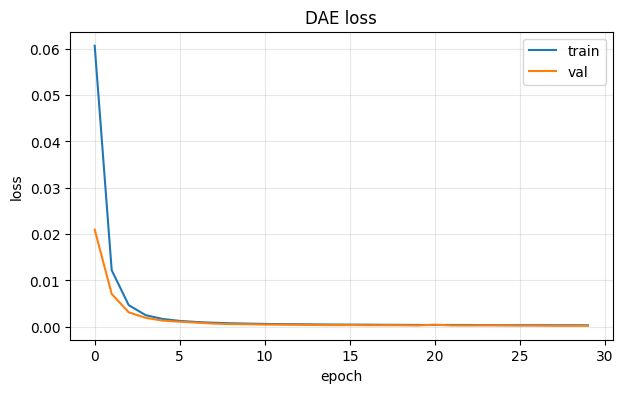

In [16]:

import matplotlib.pyplot as plt
plt.figure(figsize=(7,4))
plt.plot(train_losses, label="train")
plt.plot(val_losses, label="val")
plt.xlabel("epoch"); plt.ylabel("loss"); plt.title("DAE loss")
plt.grid(alpha=0.3); plt.legend()
plt.show()


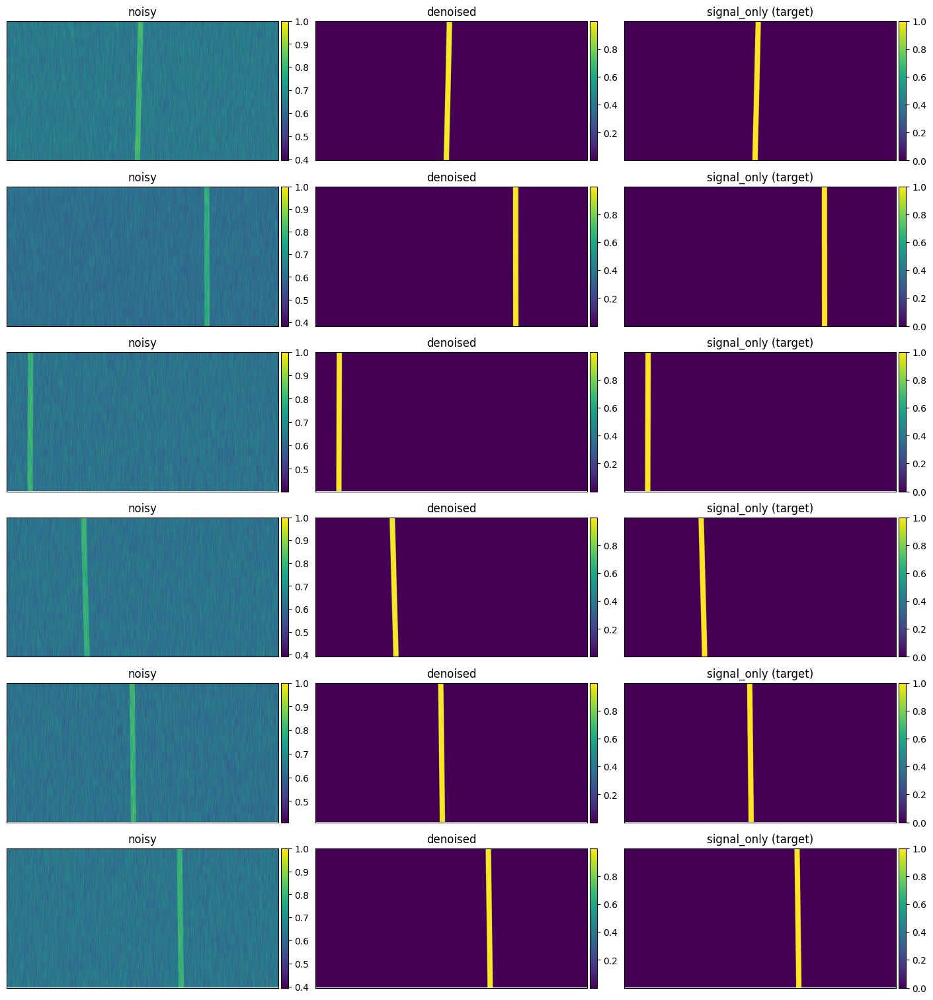

In [17]:
model.eval()
with torch.no_grad():
    noisy, sig_only, flags = next(iter(testloader))  # (B,1,16,4096), (B,1,16,4096)
    noisy = noisy.to(device, non_blocking=True)
    sig_only = sig_only.to(device, non_blocking=True)
    recon = model(noisy)  # (B,1,16,4096)

# show a few rows
Bshow = min(6, noisy.size(0))
fig, axes = plt.subplots(Bshow, 3, figsize=(14, 2.5*Bshow), constrained_layout=True)

for i in range(Bshow):
    # remove channel dim -> (16,4096)
    n = noisy[i, 0].detach().cpu().numpy()
    r = recon[i, 0].detach().cpu().numpy()
    g = sig_only[i, 0].detach().cpu().numpy()

    im0 = axes[i, 0].imshow(n, aspect='auto', cmap='viridis')
    axes[i, 0].set_title("noisy")
    im1 = axes[i, 1].imshow(r, aspect='auto', cmap='viridis')
    axes[i, 1].set_title("denoised")
    im2 = axes[i, 2].imshow(g, aspect='auto', cmap='viridis')
    axes[i, 2].set_title("signal_only (target)")

    for ax, im in zip(axes[i], [im0, im1, im2]):
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.01)
        ax.set_xticks([]); ax.set_yticks([])

plt.show()


In [18]:
import heapq


def collect_worst(loader, model, device, K=20, metric='l1'):
    """
    Scan a loader and keep the K worst items by per-sample reconstruction error.

    loader yields: (noisy, signal_only, frame_flag)
    model(noisy) -> recon, shape (B,1,16,4096)

    metric: 'l1' | 'l2' | 'bce'
    returns: list of (error, noisy[0], recon[0], target[0]) sorted desc by error
    """
    model.eval()
    heap = []  # min-heap of fixed size K

    with torch.no_grad():
        for noisy, target, _ in tqdm(loader, desc='Scanning', unit='batch'):
            noisy  = noisy.to(device, non_blocking=True)
            target = target.to(device, non_blocking=True)
            recon  = model(noisy)

            if metric == 'l1':
                per = (recon - target).abs().flatten(1).mean(1)
            elif metric == 'l2':
                per = F.mse_loss(recon, target, reduction='none').flatten(1).mean(1)
            elif metric == 'bce':
                per = F.binary_cross_entropy(
                    recon.clamp(1e-7, 1-1e-7),
                    target.clamp(0, 1),
                    reduction='none'
                ).flatten(1).mean(1)
            else:
                raise ValueError("metric must be one of: 'l1', 'l2', 'bce'")

            # move to CPU once per batch
            per_cpu = per.detach().cpu()
            n_cpu   = noisy.detach().cpu()
            r_cpu   = recon.detach().cpu()
            t_cpu   = target.detach().cpu()

            for i in range(per_cpu.shape[0]):
                # store channel-removed 2D arrays (16x4096)
                entry = (per_cpu[i].item(), n_cpu[i, 0], r_cpu[i, 0], t_cpu[i, 0])
                if len(heap) < K:
                    heapq.heappush(heap, entry)
                else:
                    if entry[0] > heap[0][0]:
                        heapq.heapreplace(heap, entry)

    return sorted(heap, key=lambda x: x[0], reverse=True)


def plot_triplets(items, title=''):
    """
    items: list of (err, noisy_2d, recon_2d, target_2d)
    Plots rows = len(items), cols = 3 with colorbars.
    """
    rows = len(items)
    fig, axes = plt.subplots(rows, 3, figsize=(14, 2.5*rows), constrained_layout=True)
    if rows == 1:
        axes = axes[None, :]  # make it 2D for consistent indexing

    for i, (err, n, r, t) in enumerate(items):
        im0 = axes[i, 0].imshow(n.numpy(), aspect='auto', cmap='viridis')
        axes[i, 0].set_title("noisy")

        im1 = axes[i, 1].imshow(r.numpy(), aspect='auto', cmap='viridis')
        axes[i, 1].set_title(f"denoised\nerr={err:.4f}")

        im2 = axes[i, 2].imshow(t.numpy(), aspect='auto', cmap='viridis')
        axes[i, 2].set_title("signal_only (target)")

        for ax, im in zip(axes[i], [im0, im1, im2]):
            ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046, pad=0.01)

    if title:
        fig.suptitle(title, fontsize=12)
    plt.show()


In [19]:
# pick your metric: 'l1' usually matches your training loss if you used L1Loss
worst_val = collect_worst(valloader, model, device, K=20, metric='l2')
plot_triplets(worst_val, title='Worst 20 — Validation (L1)')


Scanning:   0%|          | 0/35 [00:00<?, ?batch/s]

In [ ]:
# worst_test = collect_worst(testloader, model, device, K=20, metric='l2')
# plot_triplets(worst_test, title='Worst 20 — Test (L1)')


Scanning:   0%|          | 0/204 [00:00<?, ?batch/s]

KeyboardInterrupt: 

In [ ]:


def collect_errors_by_label(loader, model, device, metric='l1', desc='Scanning'):
    """
    Returns:
        errors_list (list[float]): per-sample error
        labels_list (list[str])  : matching frame_flag strings
    """
    model.eval()
    errors_list, labels_list = [], []

    with torch.no_grad():
        for noisy, target, frame_flags in tqdm(loader, desc=desc, unit='batch'):
            noisy  = noisy.to(device, non_blocking=True)
            target = target.to(device, non_blocking=True)
            recon  = model(noisy)

            if metric == 'l1':
                per = (recon - target).abs().flatten(1).mean(1)
            elif metric == 'l2':
                per = F.mse_loss(recon, target, reduction='none').flatten(1).mean(1)
            elif metric == 'bce':
                per = F.binary_cross_entropy(
                    recon.clamp(1e-7, 1-1e-7),
                    target.clamp(0, 1),
                    reduction='none'
                ).flatten(1).mean(1)
            else:
                raise ValueError("metric must be 'l1', 'l2', or 'bce'")

            # frame_flags is a list of strings (length B)
            errors_list.extend(per.detach().cpu().tolist())
            labels_list.extend(list(frame_flags))

    return errors_list, labels_list


Val errors:   0%|          | 0/35 [00:00<?, ?batch/s]

Test errors:   0%|          | 0/204 [00:00<?, ?batch/s]

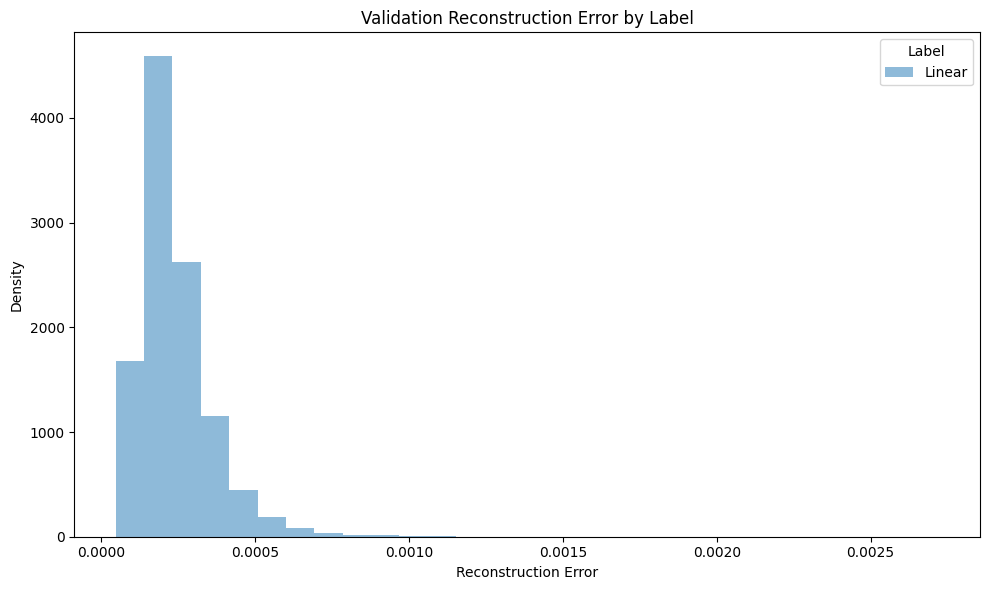

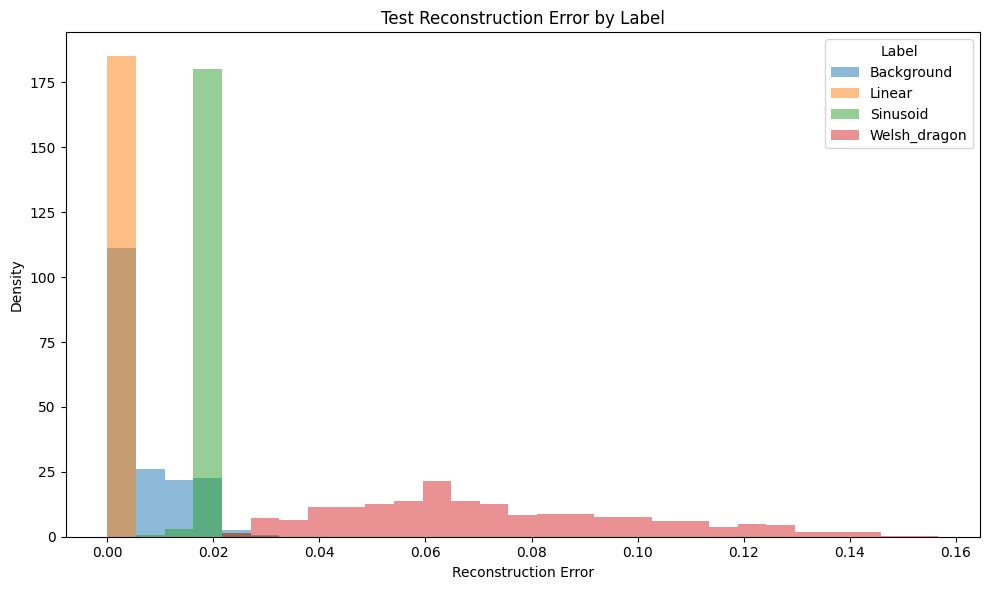

In [ ]:

# collect for validation & test (choose metric to match your training loss)
val_errors, val_labels   = collect_errors_by_label(valloader,  model, device, metric='l2', desc='Val errors')
test_errors, test_labels = collect_errors_by_label(testloader, model, device, metric='l2', desc='Test errors')

# ---------- plot (validation) ----------
errors_array = np.array(val_errors)
labels_array = np.array(val_labels)
unique_labels = np.unique(labels_array)
bins = np.linspace(errors_array.min(), errors_array.max(), 30)

plt.figure(figsize=(10, 6))
for lbl in unique_labels:
    mask = labels_array == lbl
    plt.hist(errors_array[mask],
             bins=bins,
             alpha=0.5,
             label=str(lbl),
             edgecolor='none',
             density=True)
plt.title("Validation Reconstruction Error by Label")
plt.xlabel("Reconstruction Error")
plt.ylabel("Density")
plt.legend(title="Label", loc='upper right')
plt.tight_layout()
plt.show()

# ---------- plot (test) ----------
errors_array = np.array(test_errors)
labels_array = np.array(test_labels)
unique_labels = np.unique(labels_array)
bins = np.linspace(errors_array.min(), errors_array.max(), 30)

plt.figure(figsize=(10, 6))
for lbl in unique_labels:
    mask = labels_array == lbl
    plt.hist(errors_array[mask],
             bins=bins,
             alpha=0.5,
             label=str(lbl),
             edgecolor='none',
             density=True)
plt.title("Test Reconstruction Error by Label")
plt.xlabel("Reconstruction Error")
plt.ylabel("Density")
plt.legend(title="Label", loc='upper right')
plt.tight_layout()
plt.show()


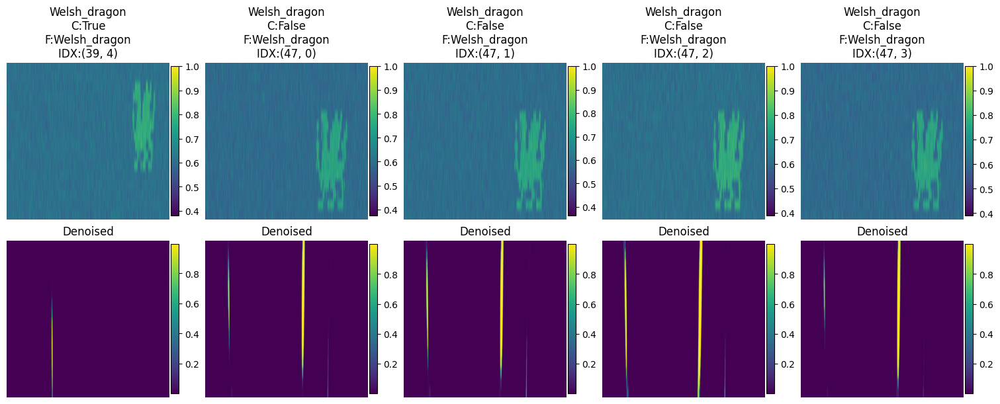

In [ ]:
# Pick first N Welsh_dragon samples from the *test* set and visualize
num_images = 5
indices_to_show = np.where(y_test[:, 2] == "Welsh_dragon")[0].tolist()
indices_to_show = indices_to_show[5:5 + num_images]  # skip first few, take next num_images

# Stack the *noisy* frames from the dataset
sample_data  = torch.stack([test_dataset[i][0] for i in indices_to_show]).to(device, non_blocking=True)
sample_labels = [y_test[i] for i in indices_to_show]

model.eval()
with torch.no_grad():
    reconstructed = model(sample_data)  # DAE: just the reconstruction

# Plot
fig, axes = plt.subplots(2, num_images, figsize=(3 * num_images, 6), constrained_layout=True)
for col, i_ds in enumerate(indices_to_show):
    inj_type, cadence_label, frame_flag, orig_idx = sample_labels[col]

    ax0 = axes[0, col]
    im0 = ax0.imshow(sample_data[col, 0].detach().cpu().numpy(), aspect='auto', cmap='viridis')
    ax0.set_title(f"{inj_type}\nC:{cadence_label}\nF:{frame_flag}\nIDX:{orig_idx}")
    ax0.axis("off")
    plt.colorbar(im0, ax=ax0, fraction=0.046, pad=0.01)

    ax1 = axes[1, col]
    im1 = ax1.imshow(reconstructed[col, 0].detach().cpu().numpy(), aspect='auto', cmap='viridis')
    ax1.set_title("Denoised")
    ax1.axis("off")
    plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.01)

plt.show()


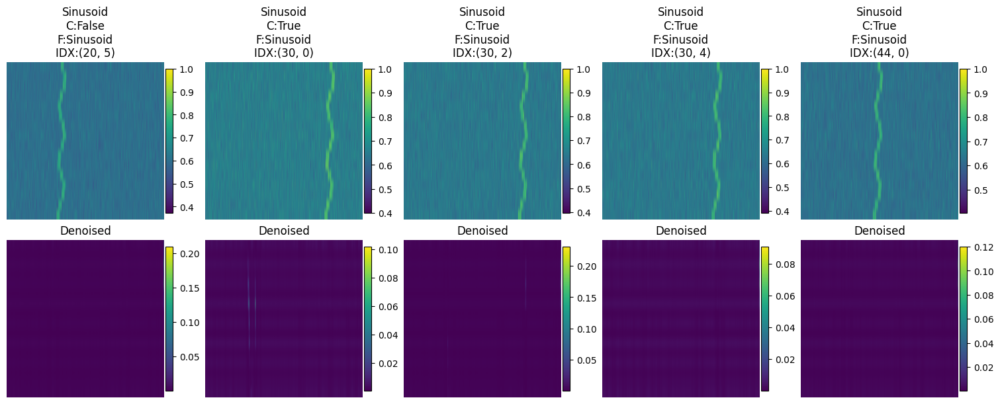

In [ ]:
# Pick first N Welsh_dragon samples from the *test* set and visualize
num_images = 5
indices_to_show = np.where(y_test[:, 2] == "Sinusoid")[0].tolist()
indices_to_show = indices_to_show[5:5 + num_images]  # skip first few, take next num_images

# Stack the *noisy* frames from the dataset
sample_data  = torch.stack([test_dataset[i][0] for i in indices_to_show]).to(device, non_blocking=True)
sample_labels = [y_test[i] for i in indices_to_show]

model.eval()
with torch.no_grad():
    reconstructed = model(sample_data)  # DAE: just the reconstruction

# Plot
fig, axes = plt.subplots(2, num_images, figsize=(3 * num_images, 6), constrained_layout=True)
for col, i_ds in enumerate(indices_to_show):
    inj_type, cadence_label, frame_flag, orig_idx = sample_labels[col]

    ax0 = axes[0, col]
    im0 = ax0.imshow(sample_data[col, 0].detach().cpu().numpy(), aspect='auto', cmap='viridis')
    ax0.set_title(f"{inj_type}\nC:{cadence_label}\nF:{frame_flag}\nIDX:{orig_idx}")
    ax0.axis("off")
    plt.colorbar(im0, ax=ax0, fraction=0.046, pad=0.01)

    ax1 = axes[1, col]
    im1 = ax1.imshow(reconstructed[col, 0].detach().cpu().numpy(), aspect='auto', cmap='viridis')
    ax1.set_title("Denoised")
    ax1.axis("off")
    plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.01)

plt.show()


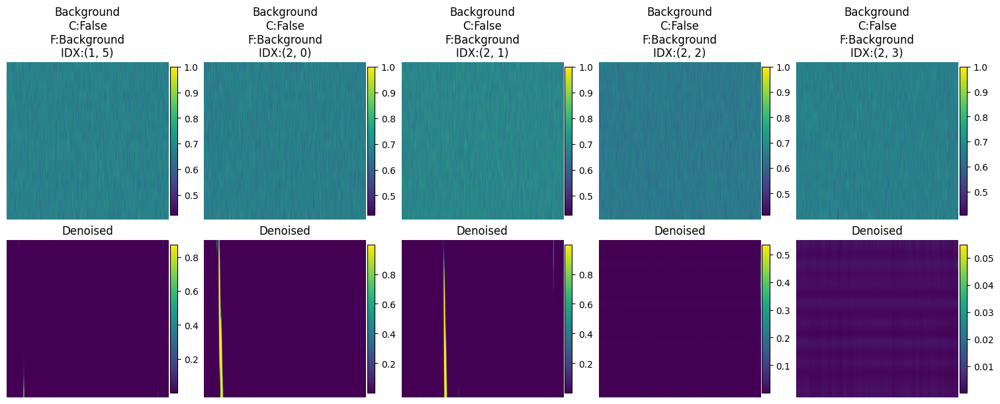

In [ ]:
# Pick first N Welsh_dragon samples from the *test* set and visualize
num_images = 5
indices_to_show = np.where(y_test[:, 2] == "Background")[0].tolist()
indices_to_show = indices_to_show[5:5 + num_images]  # skip first few, take next num_images

# Stack the *noisy* frames from the dataset
sample_data  = torch.stack([test_dataset[i][0] for i in indices_to_show]).to(device, non_blocking=True)
sample_labels = [y_test[i] for i in indices_to_show]

model.eval()
with torch.no_grad():
    reconstructed = model(sample_data)  # DAE: just the reconstruction

# Plot
fig, axes = plt.subplots(2, num_images, figsize=(3 * num_images, 6), constrained_layout=True)
for col, i_ds in enumerate(indices_to_show):
    inj_type, cadence_label, frame_flag, orig_idx = sample_labels[col]

    ax0 = axes[0, col]
    im0 = ax0.imshow(sample_data[col, 0].detach().cpu().numpy(), aspect='auto', cmap='viridis')
    ax0.set_title(f"{inj_type}\nC:{cadence_label}\nF:{frame_flag}\nIDX:{orig_idx}")
    ax0.axis("off")
    plt.colorbar(im0, ax=ax0, fraction=0.046, pad=0.01)

    ax1 = axes[1, col]
    im1 = ax1.imshow(reconstructed[col, 0].detach().cpu().numpy(), aspect='auto', cmap='viridis')
    ax1.set_title("Denoised")
    ax1.axis("off")
    plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.01)

plt.show()


Encoding test set:   0%|          | 0/204 [00:00<?, ?it/s]

/tmp/ipykernel_2287704/227278286.py:22: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab10", len(unique_tags))


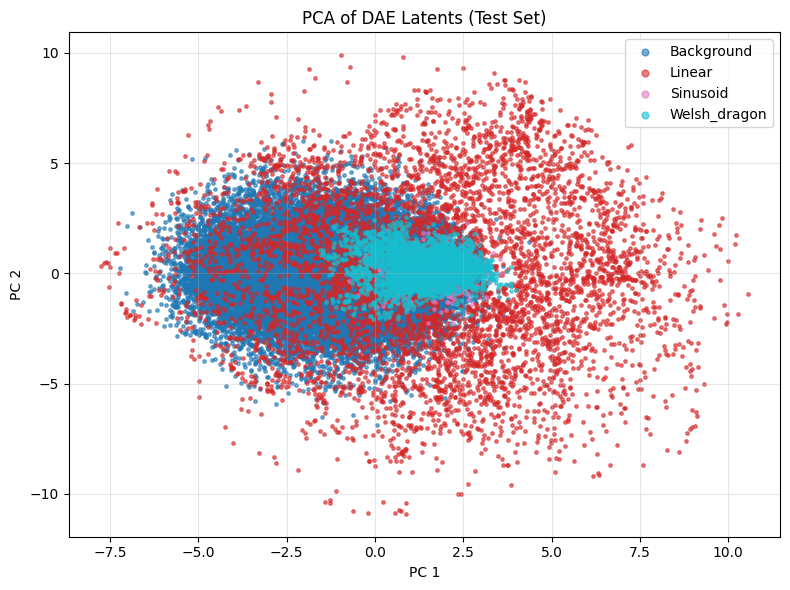

In [ ]:
from sklearn.decomposition import PCA


# 1) Encode all test samples to latent z
model.eval()
latents = []
with torch.no_grad():
    for noisy, _, _ in tqdm(testloader, desc="Encoding test set"):
        noisy = noisy.to(device, non_blocking=True)
        z = model.encode(noisy)       # (B, latent_dim)
        latents.append(z.cpu())
all_latents = torch.cat(latents, dim=0).numpy()  # (N_test, latent_dim)

# 2) Collect frame tags from y_test (3rd element is frame_flag)
frame_tags = np.array([lab[2] for lab in y_test])

# 3) PCA → 2D
latent_2d = PCA(n_components=2).fit_transform(all_latents)

# 4) Scatter by tag
unique_tags = np.unique(frame_tags)
cmap = plt.cm.get_cmap("tab10", len(unique_tags))

plt.figure(figsize=(8, 6))
for idx, tag in enumerate(unique_tags):
    mask = frame_tags == tag
    plt.scatter(latent_2d[mask, 0], latent_2d[mask, 1],
                s=6, alpha=0.6, color=cmap(idx), label=str(tag))
plt.title("PCA of DAE Latents (Test Set)")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.legend(markerscale=2)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


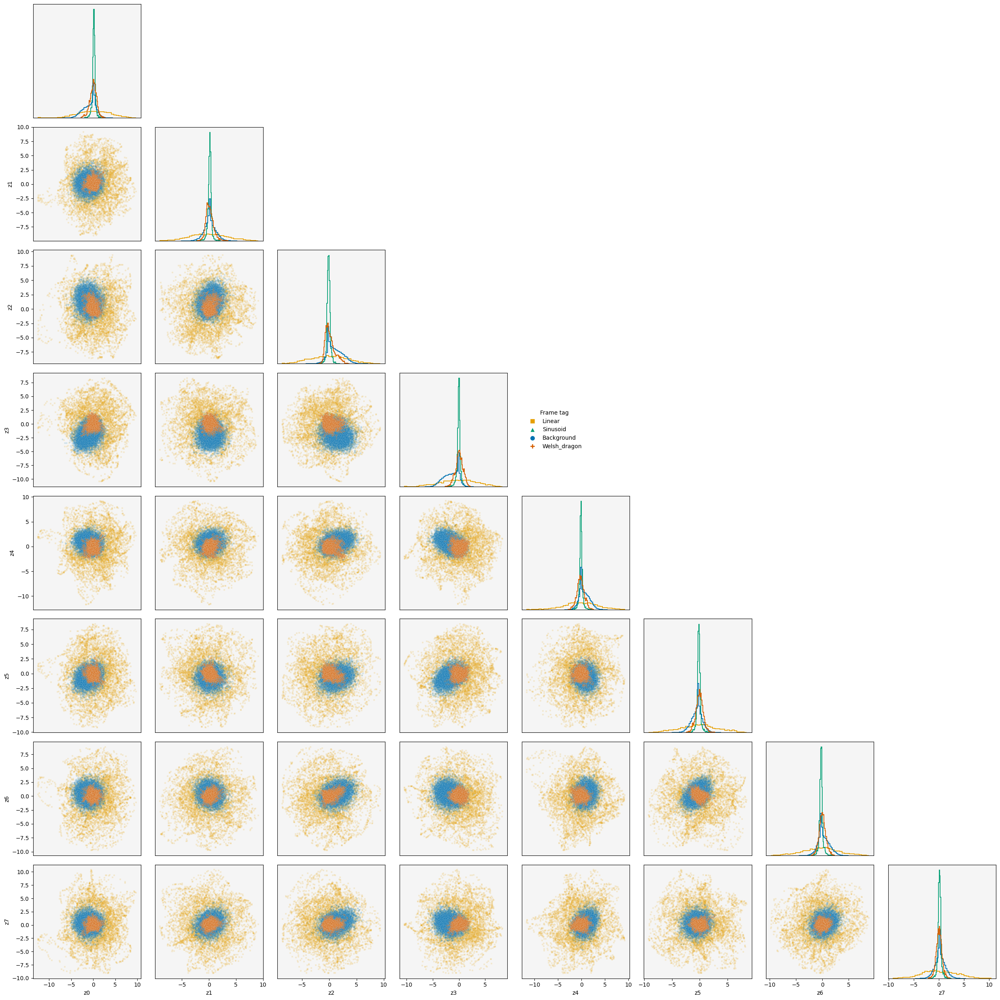

In [ ]:
# ╔════════════ Scatter-matrix (blue/green CVD-safe; Background on top) ═══════════╗

from matplotlib.lines import Line2D

# ── 1. Data ➝ NumPy ───────────────────────────────────────────────────────────
Z = (all_latents.detach().cpu().numpy()
     if torch.is_tensor(all_latents) else np.asarray(all_latents))
tags = np.asarray(frame_tags)

_, n_dims = Z.shape
dim_labels = [f"z{i}" for i in range(n_dims)]

# ── 2. Okabe–Ito palette & shapes ─────────────────────────────────────────────
colour_map = {
    "Background"   : "#0072B2",   # blue  (CVD-safe)
    "Linear"       : "#E69F00",   # orange
    "Sinusoid"     : "#009E73",   # green (CVD-safe vs blue)
    "Welsh_dragon" : "#D55E00",   # vermillion
}
marker_map = {
    "Background"   : "o",
    "Linear"       : "s",
    "Sinusoid"     : "^",
    "Welsh_dragon" : "P",
}

def c(tag): return colour_map.get(tag, "#666666")
def m(tag): return marker_map.get(tag, "o")

unique_tags = np.unique(tags)

# ── 3. Sub-sampling parameters ────────────────────────────────────────────────
plot_sample  = 10_000
subsamp_tags = {"Background", "Linear", "Sinusoid", "Welsh_dragon"}

# ── 4. Explicit draw order: Linear → Sinusoid → Background → Welsh_dragon ────
tag_order = ["Linear", "Sinusoid", "Background", "Welsh_dragon"]
tag_order = [t for t in tag_order if t in unique_tags]  # keep existing only

# ── 5. Figure & grid ─────────────────────────────────────────────────────────
fig, axes = plt.subplots(
    n_dims, n_dims,
    figsize=(3.1 * n_dims, 3.1 * n_dims),
    subplot_kw={'facecolor': 'whitesmoke'}
)
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# ── 6. Plot loop ─────────────────────────────────────────────────────────────
for i in range(n_dims):
    for j in range(n_dims):
        ax = axes[i, j]

        # Diagonal: probability-density histograms
        if i == j:
            for tag in tag_order:
                mask = tags == tag
                data_i = Z[mask, i]

                # if tag == "Background":
                #     # manual histogram → scale heights by 0.001
                #     heights, bins = np.histogram(data_i, bins=40, density=True)
                #     heights *= 0.01
                #     bin_centres = 0.5*(bins[:-1] + bins[1:])
                #     ax.step(
                #         bin_centres, heights,
                #         where='mid',
                #         color=c(tag),
                #         linewidth=1.3
                #     )
                # else:
                ax.hist(
                    data_i,
                    bins=40,
                    density=True,
                    histtype='step',
                    color=c(tag),
                    linewidth=1.3
                )

            ax.set_ylabel('')
            ax.set_yticks([])

        # Lower-triangle: scatter panels
        elif i > j:
            for tag in tag_order:
                mask = tags == tag

                if tag in subsamp_tags and mask.sum() > plot_sample:
                    keep = np.random.choice(np.where(mask)[0], plot_sample, replace=False)
                    mask = np.zeros_like(mask, dtype=bool); mask[keep] = True

                ax.scatter(
                    Z[mask, j], Z[mask, i],
                    s       = 10 if tag in subsamp_tags else 20,
                    alpha   = 0.15 if tag in subsamp_tags else 0.5,
                    color   = c(tag),
                    marker  = m(tag),
                    edgecolors='white', linewidths=0.25,
                    zorder  = {"Linear":2, "Sinusoid":2,
                               "Background":2, "Welsh_dragon":2}.get(tag, 3)
                )
        else:
            ax.axis('off')

        # Labels on outer edge only
        if i == n_dims - 1 and j <= i:
            ax.set_xlabel(dim_labels[j])
        else:
            ax.set_xticks([])
        if j == 0 and i != 0:
            ax.set_ylabel(dim_labels[i])
        else:
            ax.set_yticks([])

# ── 7. Legend over z4 / right of z3 ──────────────────────────────────────────
legend_row, legend_col = 3, 4
if legend_row >= n_dims or legend_col >= n_dims:
    legend_row, legend_col = 0, n_dims - 1
legend_ax = axes[legend_row, legend_col]
legend_ax.axis('off')

handles = [
    Line2D([], [], linestyle='', marker=m(tag), markersize=9,
           markeredgecolor='white', color=c(tag), label=tag)
    for tag in tag_order
]
legend_ax.legend(
    handles=handles, title='Frame tag',
    loc='center left', bbox_to_anchor=(0.0, 0.5), frameon=False
)

plt.tight_layout()
plt.savefig("Output_corner_forNAM_2.pdf")
plt.show()

/tmp/ipykernel_2287704/1034299301.py:134: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


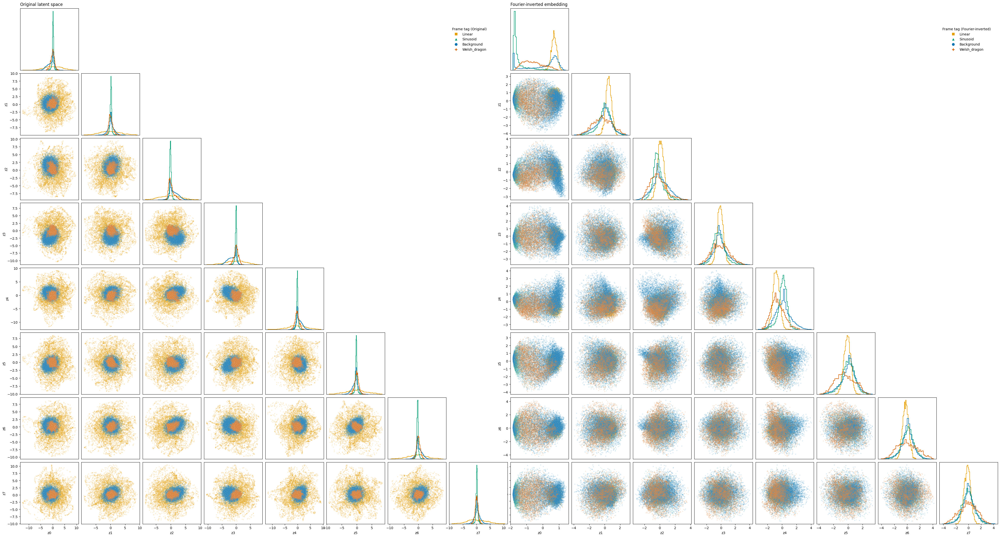

In [ ]:
from matplotlib.lines import Line2D
from matplotlib import gridspec
from sklearn.decomposition import PCA

# ── 1. Data ➝ NumPy ───────────────────────────────────────────────────────────
Z = (all_latents.detach().cpu().numpy()
     if torch.is_tensor(all_latents) else np.asarray(all_latents))
tags = np.asarray(frame_tags)

N, n_dims = Z.shape
dim_labels = [f"z{i}" for i in range(n_dims)]

# ── 2. Fourier "width inversion" embedding (unsupervised) ─────────────────────
# Learn transform on all data (no labels used)
Z0 = Z - Z.mean(axis=0, keepdims=True)

# Random Fourier features: draw per-dimension scales for frequencies
R = max(128, 8 * n_dims)                 # number of base frequencies
std_per_dim = Z0.std(axis=0, ddof=1)     # shape (D,)
std_per_dim[std_per_dim == 0] = 1.0      # avoid div-by-zero
omega_scale = 1.0 / std_per_dim          # per-dim frequency scale ~ inverse width

rng = np.random.default_rng(42)
# Each column j of Omega gets its own scale
Omega = rng.normal(loc=0.0, scale=omega_scale, size=(R, n_dims))   # shape (R, D)
b = rng.uniform(0.0, 2*np.pi, size=(R,))                           # shape (R,)

proj = Z0 @ Omega.T                                                # (N, R)
Phi = np.concatenate([np.cos(proj + b), np.sin(proj + b)], axis=1) # (N, 2R)
Phi *= (1.0 / np.sqrt(R))                                          # variance control

# Compress back to D dimensions only for plotting (still unsupervised)
pca = PCA(n_components=n_dims, whiten=True, random_state=42)
Z_fourier = pca.fit_transform(Phi)                                 # (N, D)

# ── 3. Shared plot config ─────────────────────────────────────────────────────
colour_map = {
    "Background"   : "#0072B2",
    "Linear"       : "#E69F00",
    "Sinusoid"     : "#009E73",
    "Welsh_dragon" : "#D55E00",
}
marker_map = {
    "Background"   : "o",
    "Linear"       : "s",
    "Sinusoid"     : "^",
    "Welsh_dragon" : "P",
}
def c(tag): return colour_map.get(tag, "#666666")
def m(tag): return marker_map.get(tag, "o")

unique_tags = np.unique(tags)
tag_order   = ["Linear", "Sinusoid", "Background", "Welsh_dragon"]
tag_order   = [t for t in tag_order if t in unique_tags]

plot_sample  = 10_000
subsamp_tags = {"Background", "Linear", "Sinusoid", "Welsh_dragon"}

# ── 4. Side-by-side corner plot (Original vs Fourier-inverted) ────────────────
def corner_on_axes(Z_plot, axes, title):
    # axes is an (n_dims, n_dims) array of Axes
    for i in range(n_dims):
        for j in range(n_dims):
            ax = axes[i, j]
            if i == j:
                # Diagonal histograms
                for tag in tag_order:
                    mask = (tags == tag)
                    data_i = Z_plot[mask, i]
                    ax.hist(
                        data_i, bins=40, density=True,
                        histtype='step', color=c(tag), linewidth=1.3
                    )
                ax.set_ylabel(''); ax.set_yticks([])
            elif i > j:
                # Scatter in lower triangle
                for tag in tag_order:
                    mask = (tags == tag)
                    if tag in subsamp_tags and mask.sum() > plot_sample:
                        idx = np.flatnonzero(mask)
                        keep = rng.choice(idx, plot_sample, replace=False)
                        mask = np.zeros_like(mask, dtype=bool); mask[keep] = True
                    ax.scatter(
                        Z_plot[mask, j], Z_plot[mask, i],
                        s=10 if tag in subsamp_tags else 20,
                        alpha=0.15 if tag in subsamp_tags else 0.5,
                        color=c(tag), marker=m(tag),
                        edgecolors='white', linewidths=0.25, zorder=2
                    )
            else:
                ax.axis('off')

            # Edge labels only
            if i == n_dims - 1 and j <= i:
                ax.set_xlabel(dim_labels[j])
            else:
                ax.set_xticks([])
            if j == 0 and i != 0:
                ax.set_ylabel(dim_labels[i])
            else:
                ax.set_yticks([])

    # Title on the top-left panel’s super-axis: place as suptitle later
    # Legend in the top-right panel
    legend_ax = axes[0, n_dims - 1]
    legend_ax.axis('off')
    handles = [Line2D([], [], linestyle='', marker=m(tag), markersize=9,
                      markeredgecolor='white', color=c(tag), label=tag)
               for tag in tag_order]
    legend_ax.legend(handles=handles, title=title,
                     loc='center left', bbox_to_anchor=(0.0, 0.5), frameon=False)

# Create a big grid: left block = Original, right block = Fourier-inverted
fig = plt.figure(figsize=(6.4 * 2 * n_dims / 2, 3.4 * n_dims))  # wide figure
gs = gridspec.GridSpec(nrows=n_dims, ncols=2 * n_dims, figure=fig,
                       wspace=0.05, hspace=0.05)

# Allocate axes arrays
axes_left  = np.empty((n_dims, n_dims), dtype=object)
axes_right = np.empty((n_dims, n_dims), dtype=object)
for i in range(n_dims):
    for j in range(n_dims):
        axes_left[i, j]  = fig.add_subplot(gs[i, j])
        axes_right[i, j] = fig.add_subplot(gs[i, j + n_dims])

# Draw both corners
corner_on_axes(Z,          axes_left,  title='Frame tag (Original)')
corner_on_axes(Z_fourier,  axes_right, title='Frame tag (Fourier-inverted)')

# Top titles
axes_left[0, 0].set_title("Original latent space", loc='left', fontsize=12, pad=8)
axes_right[0, 0].set_title("Fourier-inverted embedding", loc='left', fontsize=12, pad=8)

plt.tight_layout()
plt.savefig("Corner_Original_vs_FourierInverted.pdf")
plt.show()


In [16]:
def basic_signal_thresholding(dataset: np.ndarray, threshold_sigma):
    # 2. Row-wise μ and σ  →  keep last axis only (length 4096)
    mean = np.median(dataset, axis=-1, keepdims=True)  # median normalising
    std  = np.std(dataset, axis=-1, keepdims=True)

    # 3. Threshold per row: keep only values above threshold
    mask = dataset > (mean + threshold_sigma * std)

    # 4. Apply mask: zero out everything below threshold
    return np.where(mask, dataset, 0).astype(dataset.dtype)


In [17]:
y_test.shape

(51994, 4)

In [17]:
y_test.shape

(51994, 4)

In [18]:
y_test[0]

array(['Linear', False, 'Linear', (5871, 1)], dtype=object)

In [19]:
i

NameError: name 'i' is not defined

In [23]:
# y_test[:, 3] looks like array([(5871, 1), (5420, 0), ...], dtype=object)
pairs = np.array(list(y_test[:, 3]), dtype=int)   # shape (M, 2), int
i = pairs[5800:6200, 0]                                   # indices for axis 0 (N)
j = pairs[5800:6200, 1]                                   # indices for axis 1 (6)

# Advanced indexing with parallel index arrays:
# result shape -> (M, 16, 4096)
test_dataset = data[i, j, :, :]
test_signal_only_dataset= signals_only[i, j, :, :]

test_labels = y_test[5800:6200]

np.save("test_dataset.npy", test_dataset)
np.save("test_signal_only_dataset.npy", test_signal_only_dataset)
test_dataset = np.load("test_dataset.npy")

In [24]:
test_labels[0]

array(['Linear', False, 'Linear', (9721, 0)], dtype=object)

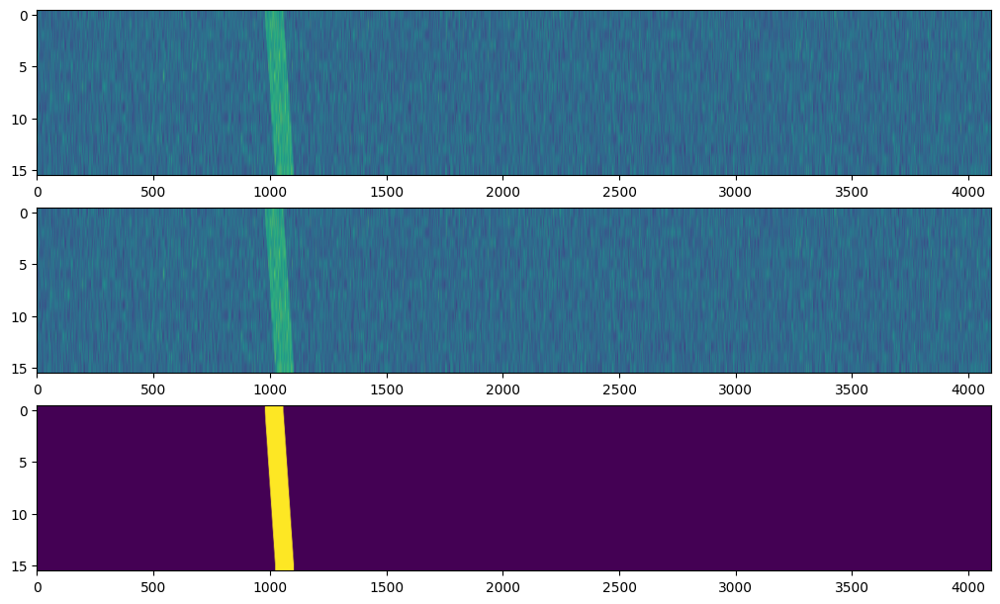

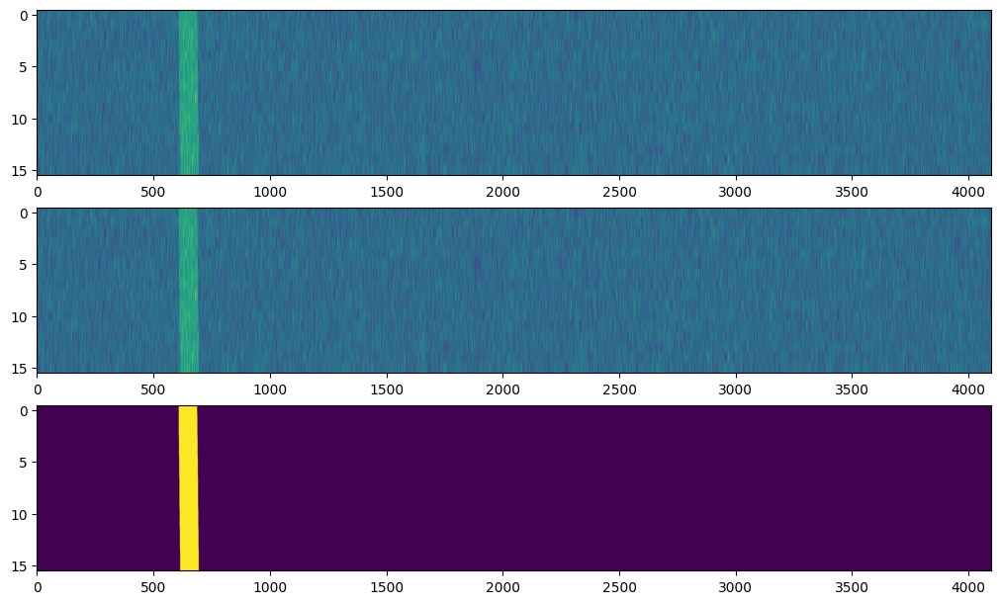

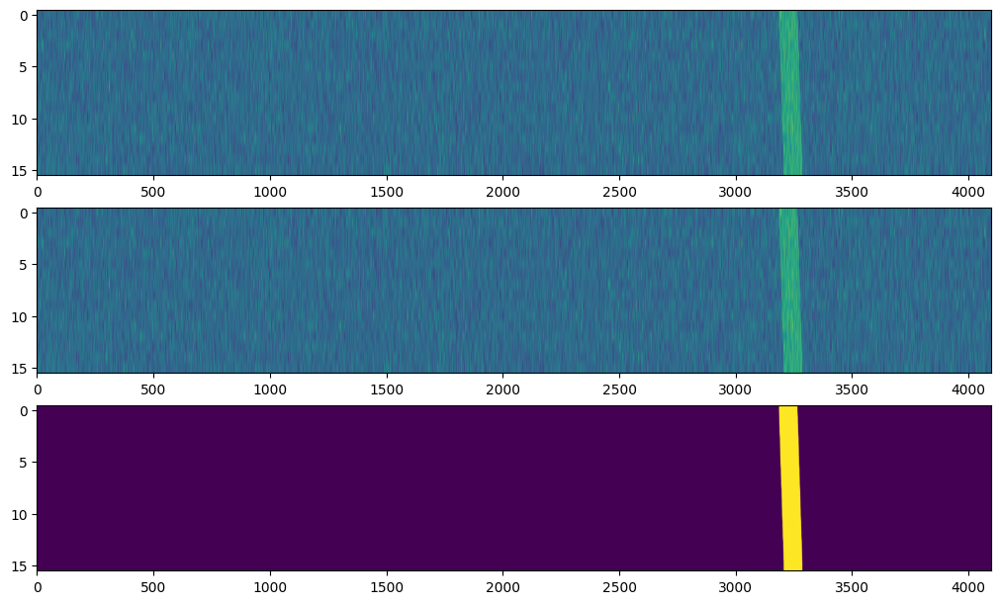

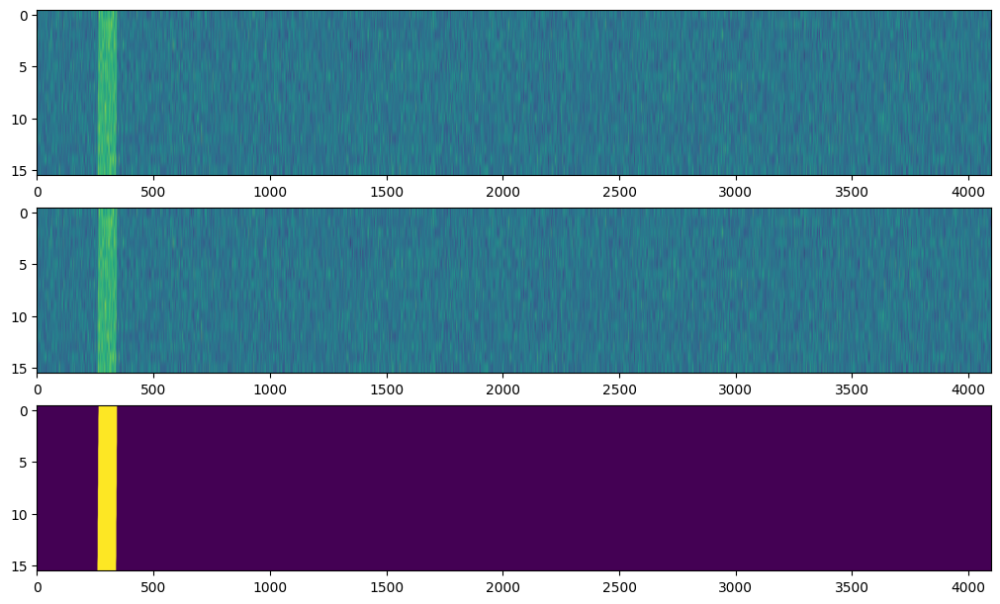

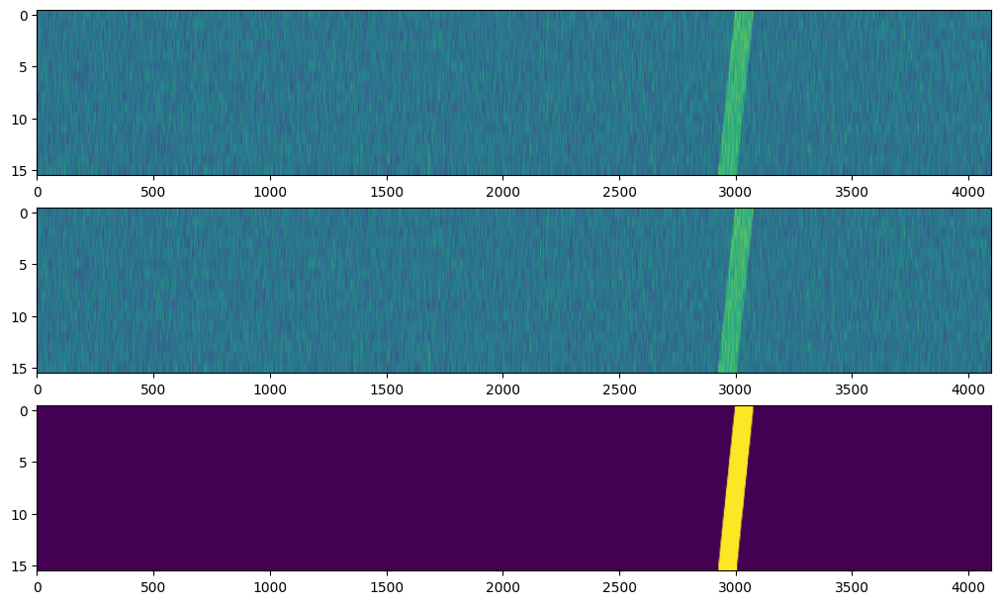

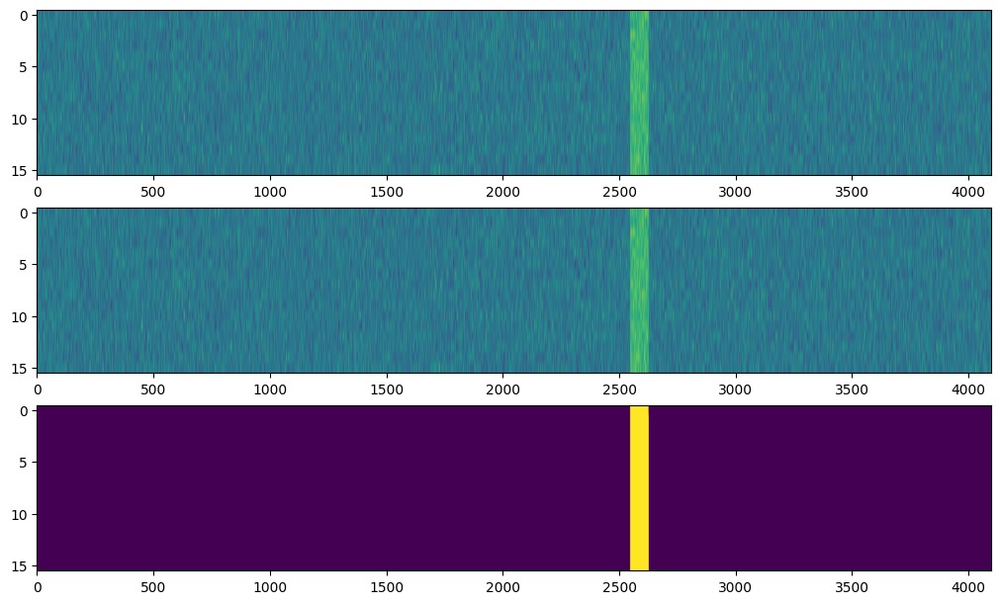

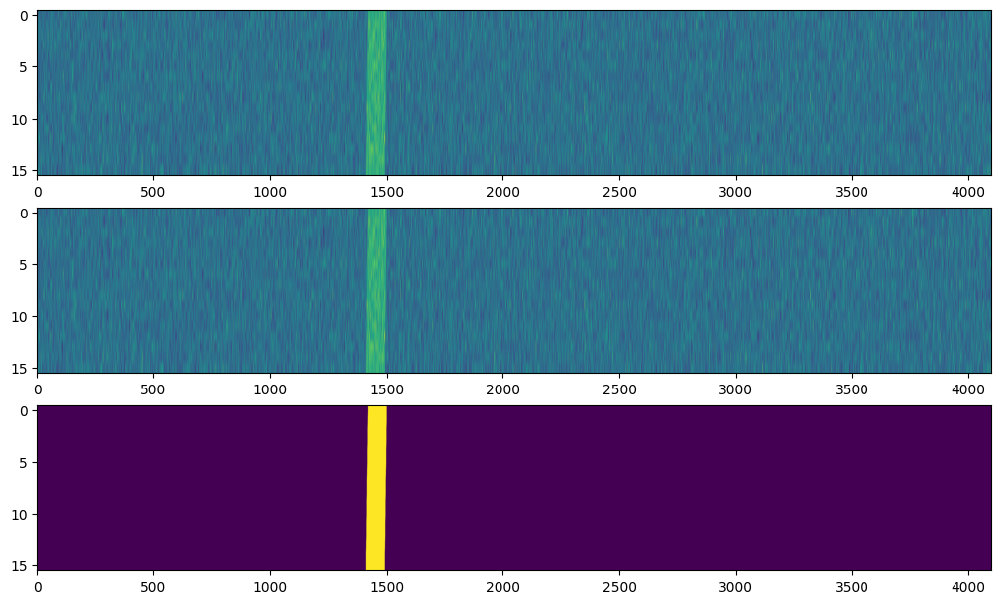

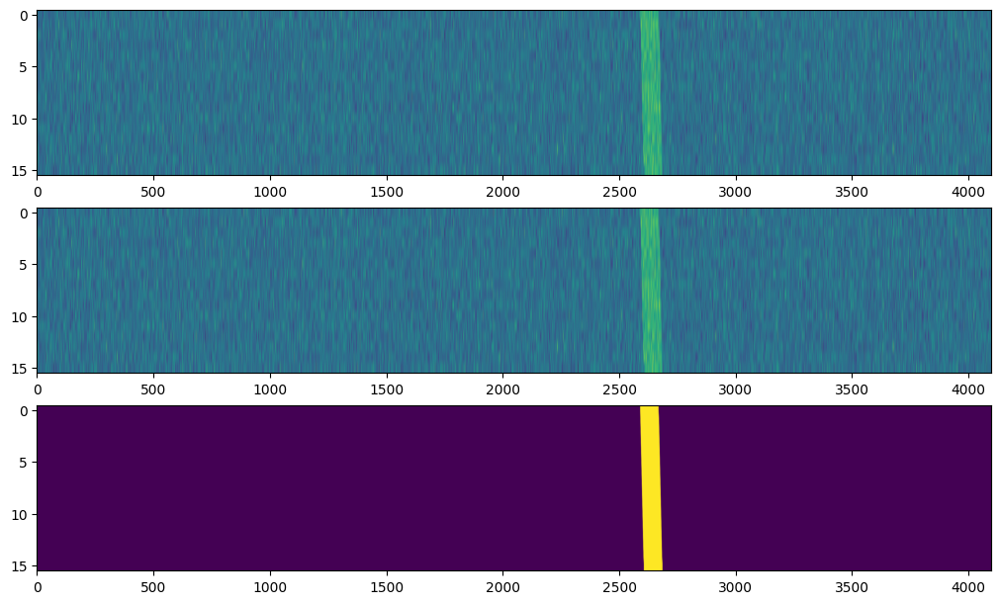

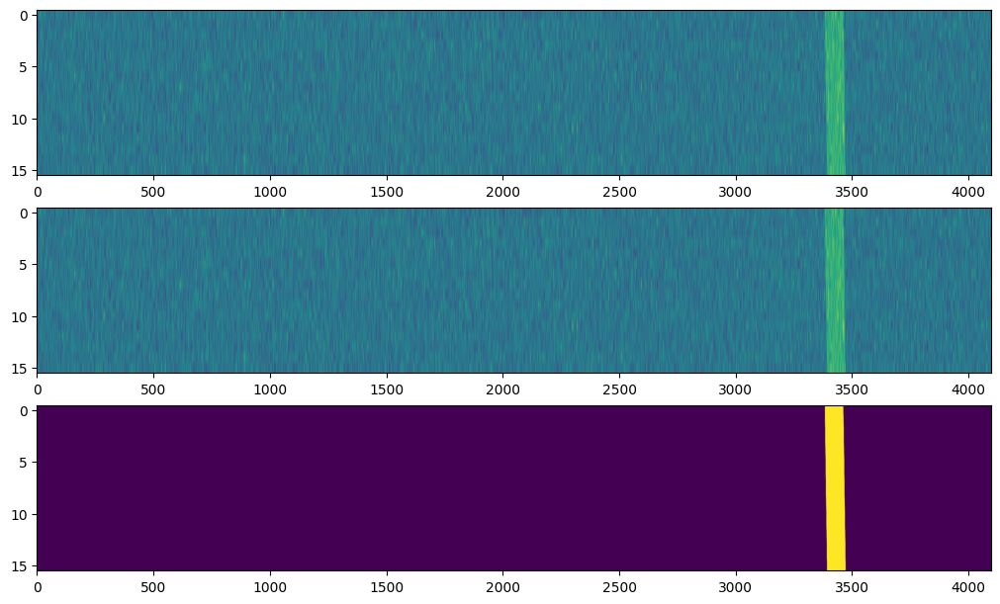

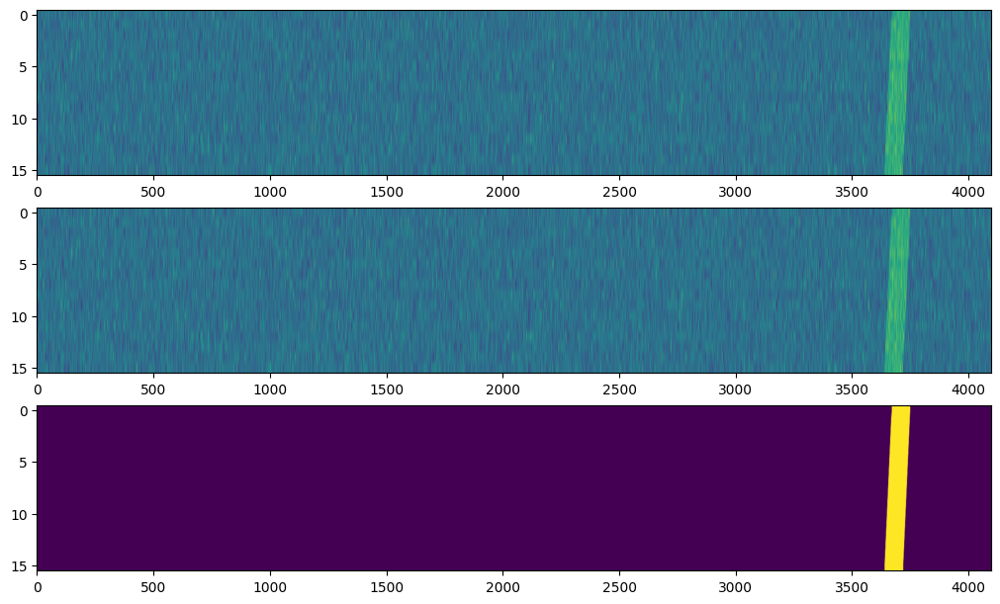

In [28]:
for i in range(10):
    fig, axs = plt.subplots(3, 1, figsize=(10, 6), constrained_layout=True)
    axs[0].imshow(test_dataset[i], aspect ="auto")
    pair = test_labels[i][3]
    a,b = pair
    axs[1].imshow(data[a,b,:,:], aspect="auto")
    axs[2].imshow(signals_only[a,b,:,:], aspect="auto")
    plt.show()



In [22]:
curr = []
count = 0
for i in tqdm(range(len(y_test))):
    inj_type, cadence_label, frame_flag, orig_idx = y_test[i]
    if frame_flag not in curr:
        curr.append(frame_flag)
        print(f"new flag of {frame_flag} at index {count}")
    count += 1 


print(curr)

  0%|          | 0/51994 [00:00<?, ?it/s]

new flag of Linear at index 0
new flag of Background at index 5914
new flag of Welsh_dragon at index 5932
new flag of Sinusoid at index 5956
['Linear', 'Background', 'Welsh_dragon', 'Sinusoid']


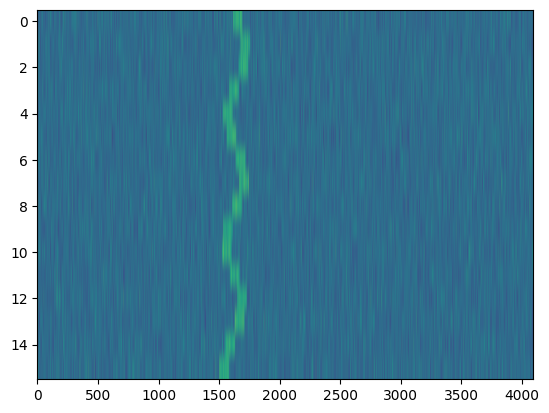

In [35]:
plt.imshow(test_dataset[56], aspect='auto')
plt.show()

In [36]:
np.save("test_dataset.npy", test_object)

NameError: name 'test_object' is not defined

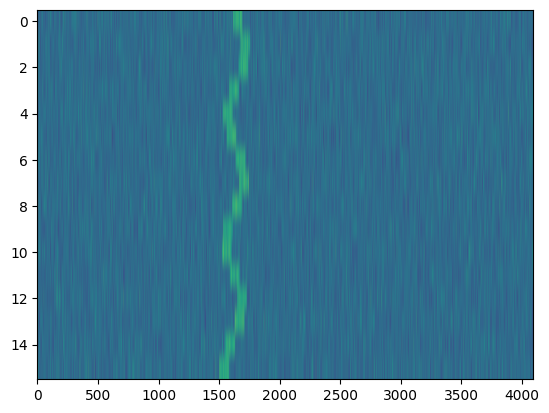

  0%|          | 0/16 [00:00<?, ?it/s]

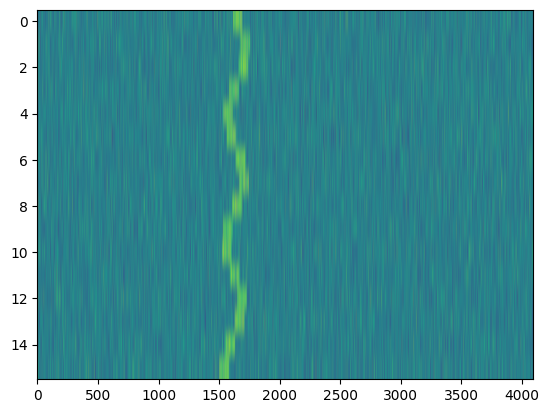

In [ ]:
test_object = test_dataset[56].copy()
plt.imshow(test_object, aspect='auto')
plt.show()

from scipy.stats import sigmaclip

# Make a copy so we don't overwrite
clipped_object = test_object.copy()

# Iterate over each row
for i in tqdm(range(clipped_object.shape[0])):
    row = clipped_object[i, :]
    
    # Perform sigma clipping (only clip high side)
    _, _, high = sigmaclip(row, low=0, high=5)
    
    # Mask / replace outliers above 'high'
    clipped_row = np.where(row <= high, row, np.nan)   # or replace np.nan with row.mean()
    
    clipped_object[i, :] = clipped_row

# Plot the clipped result
plt.imshow(clipped_object, aspect='auto')
plt.show()


In [37]:
image_clipped.shape

NameError: name 'image_clipped' is not defined

In [38]:
1+1

2

In [40]:
test_object = test_dataset[56].copy()
test_object.shape

(16, 4096)

In [87]:
low_list = [0, 0.1, 0.5]
high_list = [5, 5, 5]
for i in tqdm(range(1,6)):
    for j in range(1,6):
        if j >= i:
            low_list.append(i)
            high_list.append(j)



  0%|          | 0/5 [00:00<?, ?it/s]

In [88]:
len(low_list)

18

In [89]:
1+1

2

<function matplotlib.pyplot.show(close=None, block=None)>

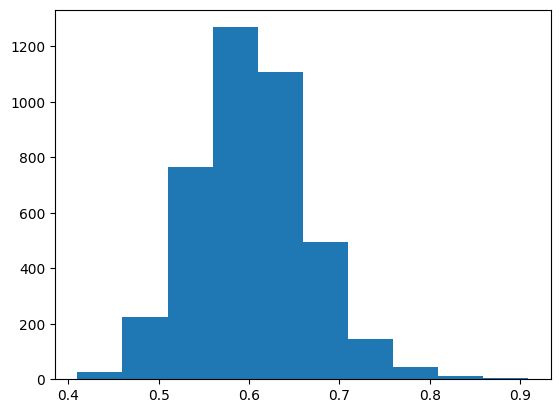

In [90]:
intensities = []
for i in test_object[0]:
    intensities.append(i)

plt.hist(intensities)
plt.show

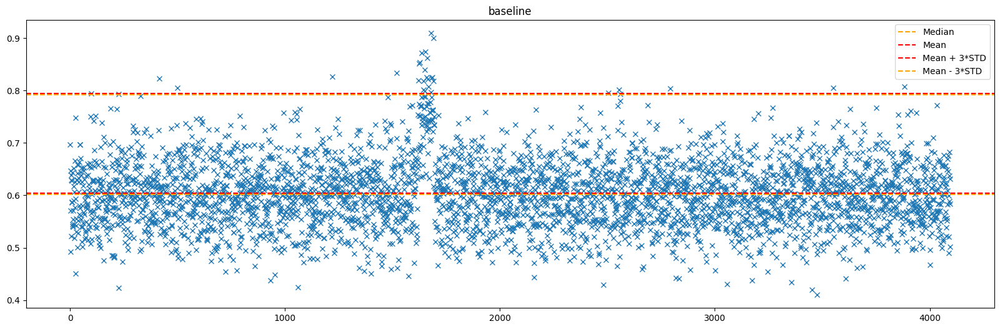

  0%|          | 0/4 [00:00<?, ?it/s]

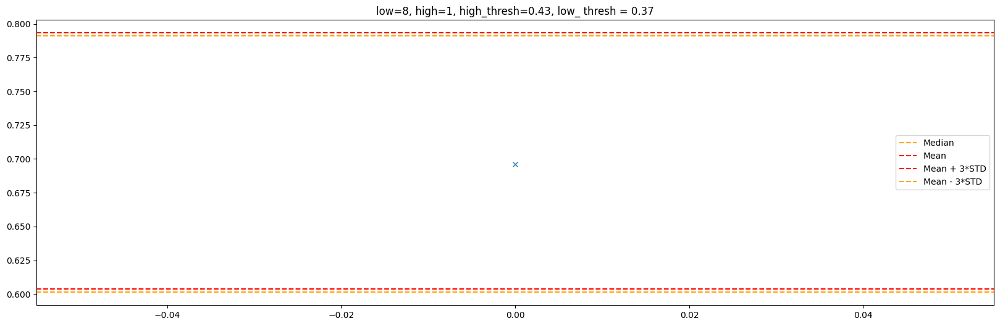

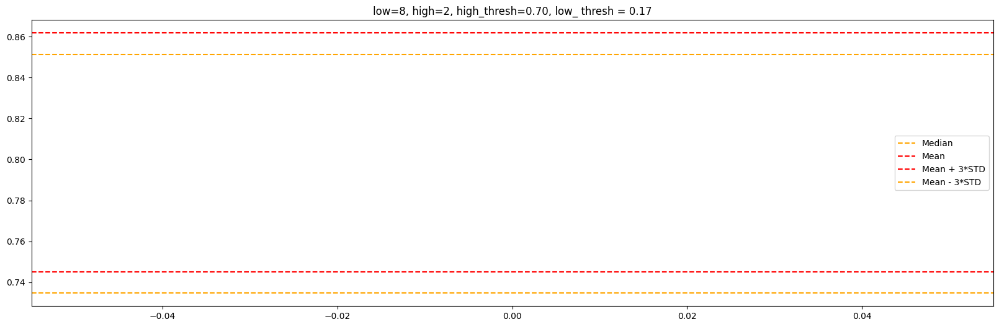

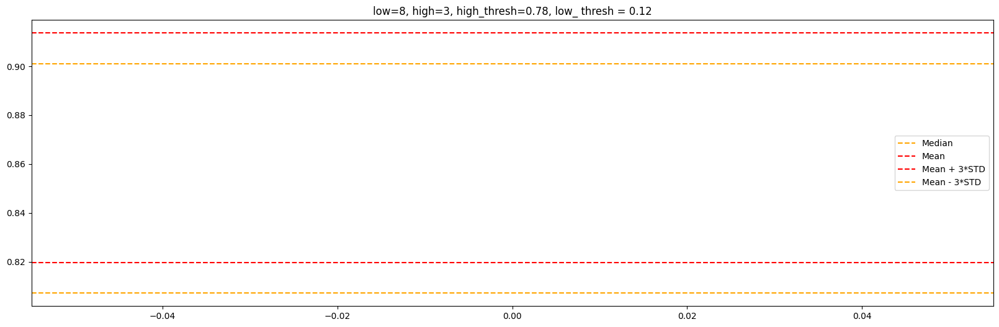

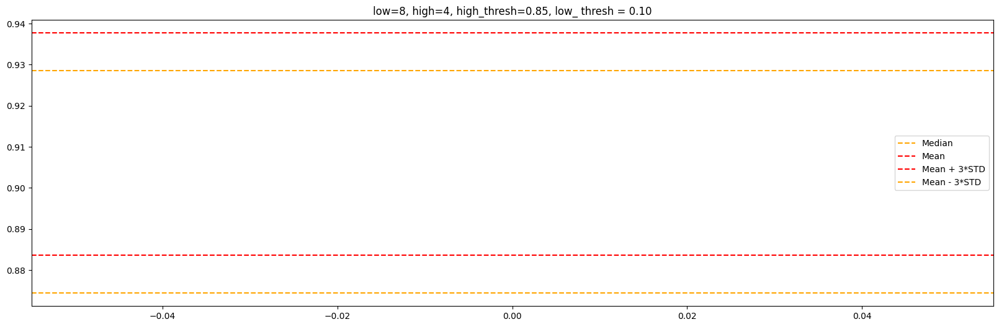

In [108]:
from scipy.stats import sigmaclip
baseline_object = test_object[0]
plt.figure(figsize=(20,6))
plt.plot(baseline_object,"x")
plt.title("baseline")
median = np.nanmedian(baseline_object)
mean = np.nanmean(baseline_object)
std = np.nanstd(baseline_object)
plt.axhline(median, color='orange', linestyle='--', label='Median')
plt.axhline(mean, color='red', linestyle='--', label='Mean')
plt.axhline(mean + 3*std, color='red', linestyle='--', label='Mean + 3*STD')
plt.axhline(median + 3*std, color='orange', linestyle='--', label='Mean - 3*STD')
plt.legend()
plt.show()
low_list = [8,8,8,8]
high_list = [1,2,3,4]
for i in tqdm(range(len(low_list))):
    # Global thresholds
    low_val = low_list[i]
    high_val = high_list[i]
    _, low, high = sigmaclip(baseline_object, low=low_val, high=high_val)

    # Mask outliers above high
    mask = (baseline_object >= high)

    image_clipped = np.where(mask, baseline_object, np.nan)   # or replace with baseline estimate

    # plt.imshow(image_clipped[0:2,:], aspect='auto', cmap='viridis')
    plt.figure(figsize=(20,6))
    plt.plot(image_clipped[0], "x")
    plt.title(f"low={low_val}, high={high_val}, high_thresh={high:.2f}, low_ thresh = {low:.2f}")
    median = np.nanmedian(image_clipped)
    mean = np.nanmean(image_clipped)
    std = np.nanstd(image_clipped)
    plt.axhline(median, color='orange', linestyle='--', label='Median')
    plt.axhline(mean, color='red', linestyle='--', label='Mean')
    plt.axhline(mean + 3*std, color='red', linestyle='--', label='Mean + 3*STD')
    plt.axhline(median + 3*std, color='orange', linestyle='--', label='Mean - 3*STD')
    plt.legend()
    plt.show()


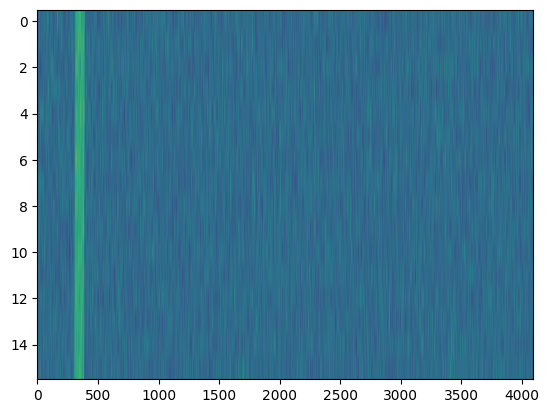

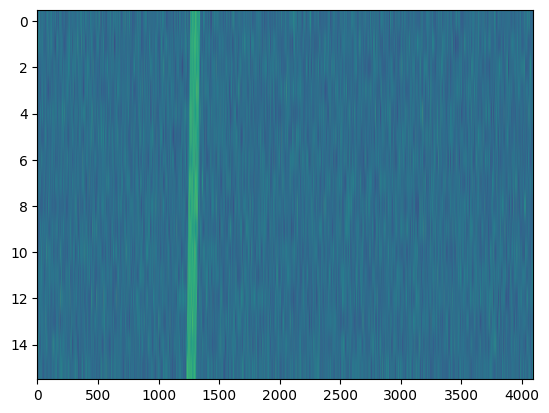

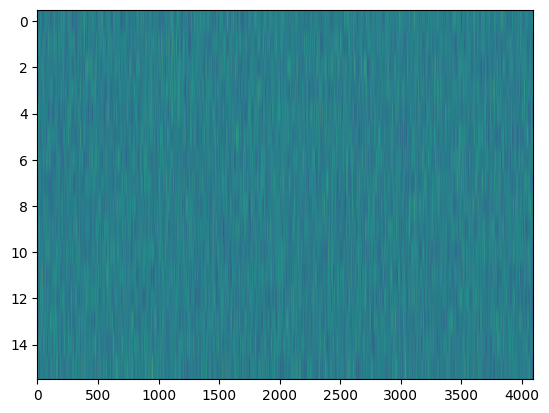

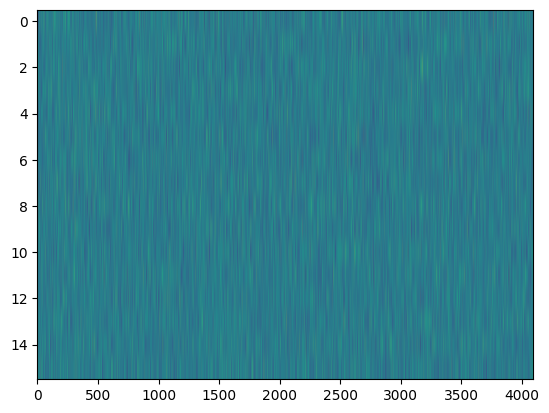

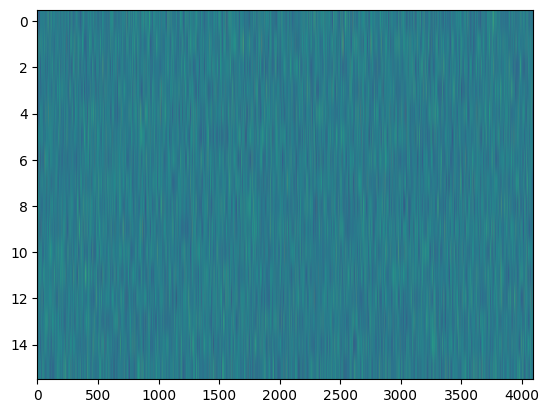

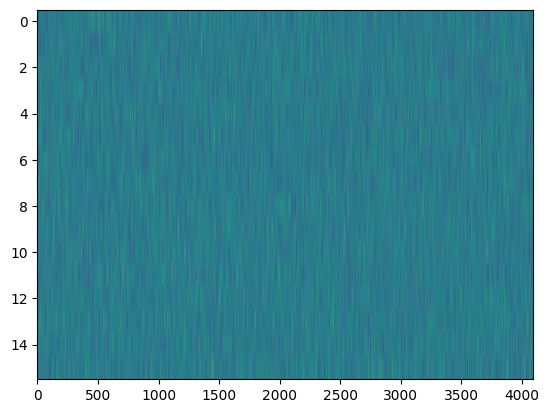

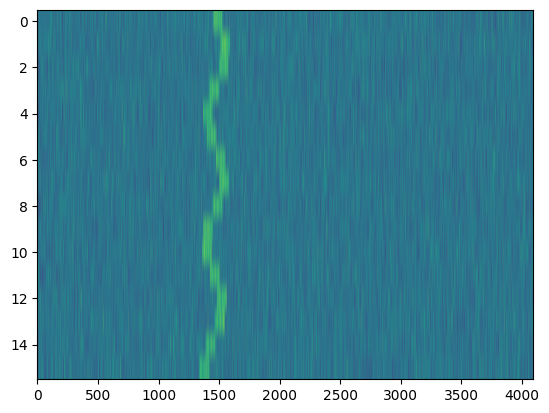

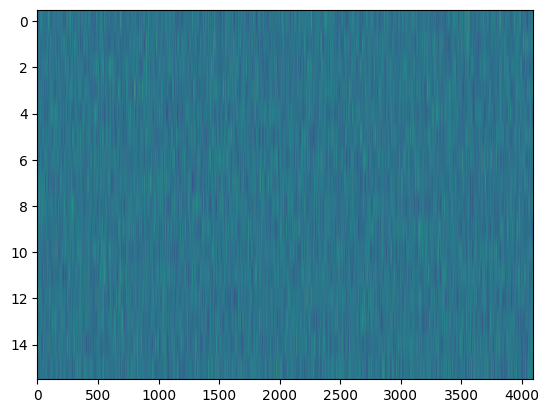

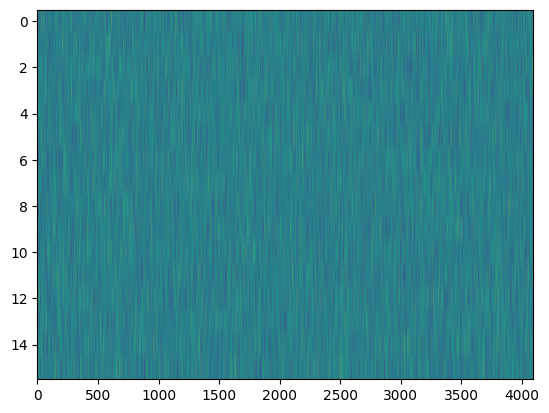

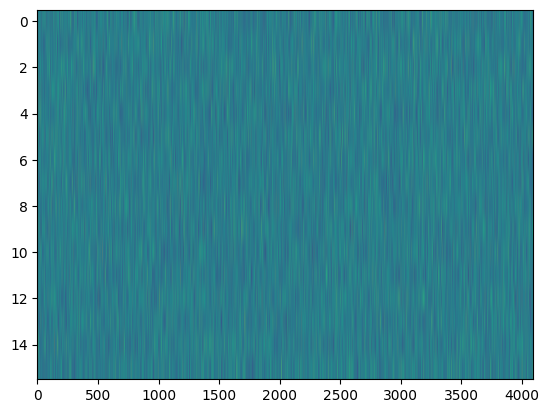

In [153]:
for i in range(0,100,10):
    plt.imshow(test_dataset[i],aspect='auto')
    plt.show()

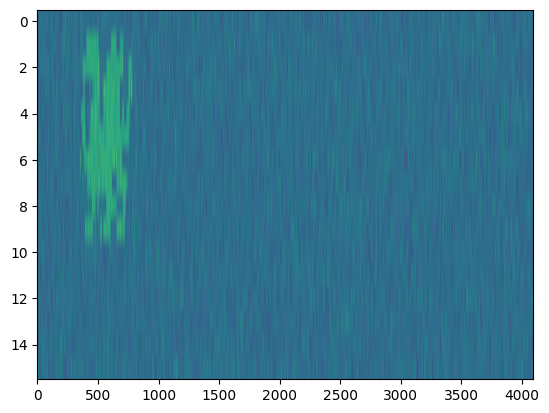

In [157]:
test_object = test_dataset[32].copy()
plt.imshow(test_object,aspect='auto')
plt.show()

Created DriftingSignalImage instance.
Computed per-row thresholds.
Raw seeds count = 279.
Consolidated seeds (pixels in groups) count = 943.
Plotting overlay and 1D rows (consolidated, pre-prune)...


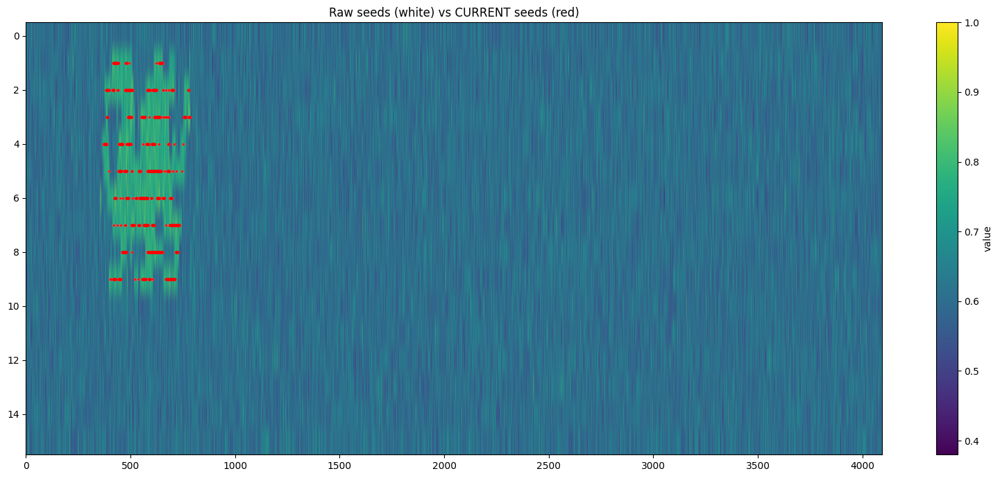

Plotting rows:   0%|          | 0/16 [00:00<?, ?it/s]

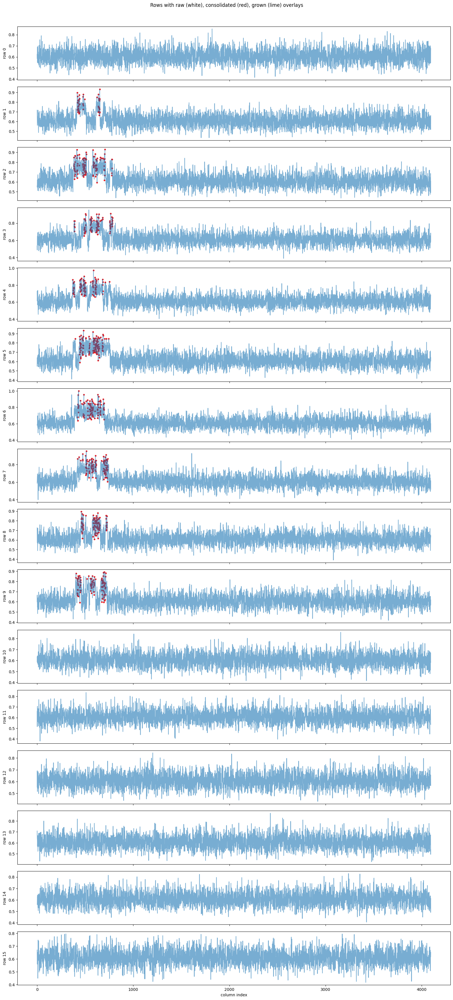

After pruning, consolidated seeds count = 925.
Plotting overlay and 1D rows (consolidated, post-prune)...


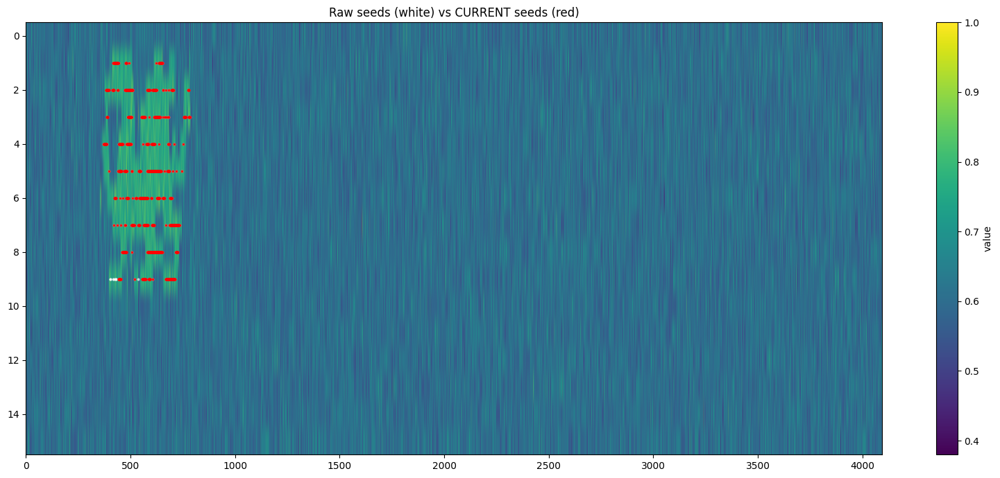

Plotting rows:   0%|          | 0/16 [00:00<?, ?it/s]

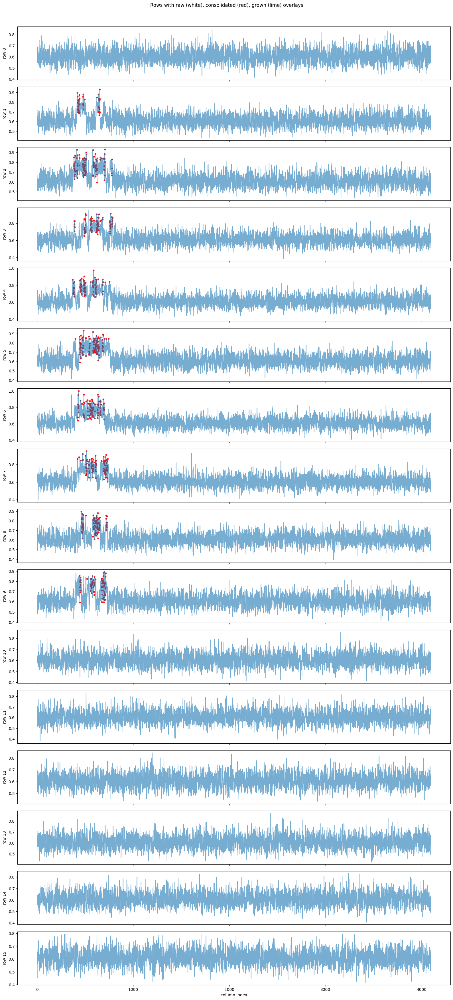

Grown-to-baseline pixels count = 2771.
Plotting overlay and 1D rows (grown-to-baseline)...


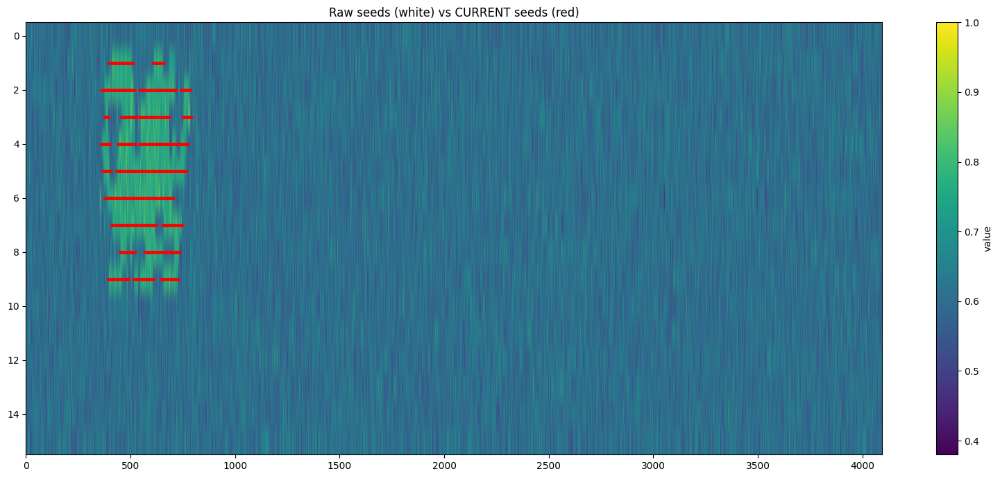

Plotting rows:   0%|          | 0/16 [00:00<?, ?it/s]

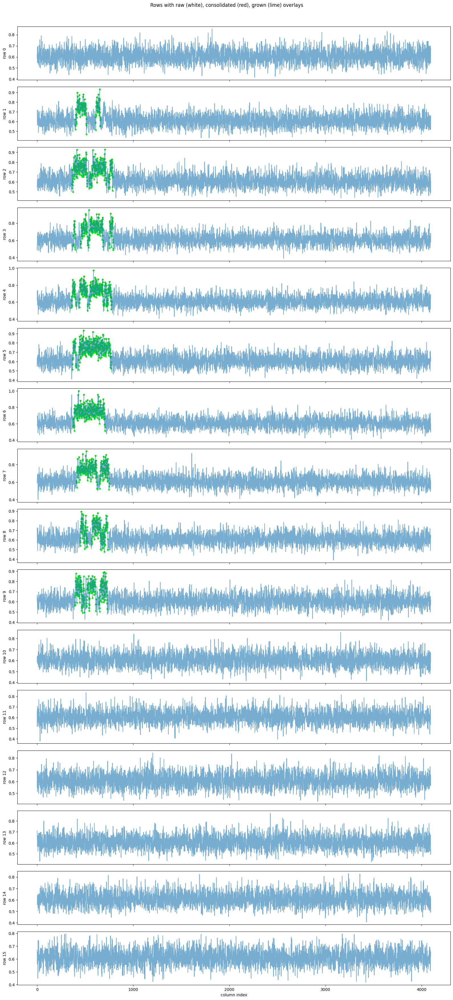

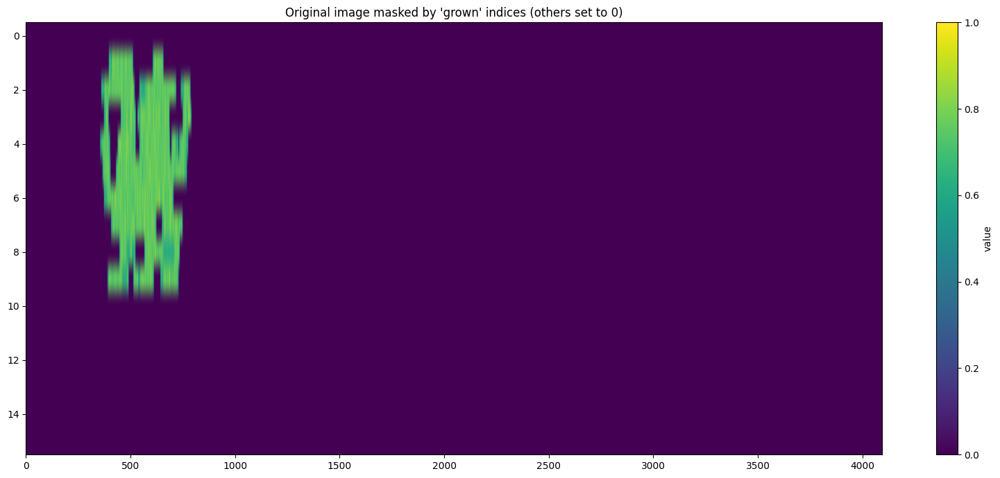

In [158]:
# ============================================================
# Object-oriented seed detection, consolidation, and plotting
# Assumes `np` and `plt` are already imported in the notebook.
# Every function includes a docstring and every line has an inline comment.
# ============================================================

class DriftingSignalImage:
    """
    Encapsulates a 2D image (rows x columns) and provides methods to:
      - compute per-row thresholds for seed detection,
      - build a raw seed boolean mask,
      - consolidate nearby seeds within each row (merge by horizontal distance),
      - plot overlays (raw seeds vs consolidated groups),
      - plot each row as a separate 1D series for inspection.
    """

    def __init__(self, image_2d):
        self.image_2d = np.asarray(image_2d, dtype=float)                     # store image as float array
        if self.image_2d.ndim != 2:                                           # validate dimensionality
            raise ValueError("image_2d must be a 2D array")                   # raise error if not 2D
        self.number_of_rows, self.number_of_columns = self.image_2d.shape     # cache shape information
        self.row_medians = None                                               # placeholder for per-row medians
        self.row_standard_deviations = None                                   # placeholder for per-row stds
        self.row_thresholds = None                                            # placeholder for per-row thresholds
        self.seed_boolean_mask = None                                         # placeholder for raw seed mask
        self.consolidated_group_boolean_mask = None                           # placeholder for consolidated mask

    @staticmethod
    def _contiguous_groups_1d(sorted_indices):
        """
        Convert sorted integer indices to contiguous spans as (start_column, end_column).
        Example: [2,3,4,10,11] -> [(2,4), (10,11)]
        """
        if sorted_indices.size == 0:                                          # no indices to process
            return []                                                         # return empty list
        break_points = np.where(np.diff(sorted_indices) > 1)[0] + 1           # find where gaps > 1 occur
        chunks = np.split(sorted_indices, break_points)                        # split into contiguous runs
        groups = [(int(chunk[0]), int(chunk[-1])) for chunk in chunks]        # make (start,end) tuples
        return groups                                                          # return contiguous groups

    def compute_row_thresholds(self, sigma_multiplier=3.0):
        """
        Compute per-row thresholds for seed detection:
        threshold[row] = median(row) + sigma_multiplier * std(row)
        """
        self.row_medians = np.nanmedian(self.image_2d, axis=1)                # compute per-row medians
        self.row_standard_deviations = np.nanstd(self.image_2d, axis=1)       # compute per-row standard deviations
        self.row_thresholds = self.row_medians + sigma_multiplier * self.row_standard_deviations  # compute thresholds
        return self.row_thresholds, self.row_medians, self.row_standard_deviations  # return results

    def build_seed_boolean_mask(self,
                                enforce_local_consensus=True,                 # if True, require local support around each seed
                                local_consensus_half_width=10,                # half-width (in columns) of the surrounding window to test
                                local_consensus_min_fraction=0.2,             # required fraction (e.g., 0.3 for 3/10) of surrounding points above local sigma threshold
                                local_sigma_multiplier=2.0):                  # local sigma multiplier for the surrounding-points test (above median + 2σ)
        """
        Build a boolean mask of raw seeds where each pixel is above its row threshold,
        and optionally require local consensus: a seed is kept only if a sufficient fraction
        of surrounding points (within a horizontal window) are also above (median + local_sigma_multiplier * std).

        Returns
        -------
        seed_boolean_mask : np.ndarray (bool)
            Boolean mask of shape (number_of_rows, number_of_columns) with True at seed positions.
        """
        if self.row_thresholds is None:                                        # ensure thresholds are available
            raise RuntimeError("compute_row_thresholds must be called first")  # enforce call order

        initial_seed_boolean_mask = self.image_2d > self.row_thresholds[:, None]  # initial seeds: value > row threshold
        initial_seed_boolean_mask &= np.isfinite(self.image_2d)                # exclude NaN / inf values

        if not enforce_local_consensus:                                        # if no local consensus required
            self.seed_boolean_mask = initial_seed_boolean_mask                 # store the initial seed mask
            return self.seed_boolean_mask                                      # return the mask unmodified

        refined_seed_boolean_mask = np.zeros_like(initial_seed_boolean_mask, dtype=bool)  # start with all-False refined mask

        for row_index in range(self.number_of_rows):                           # iterate over each row
            row_values = self.image_2d[row_index]                              # get the current row values
            row_median = self.row_medians[row_index]                           # fetch precomputed row median
            row_standard_deviation = self.row_standard_deviations[row_index]   # fetch precomputed row standard deviation
            local_threshold = row_median + local_sigma_multiplier * row_standard_deviation  # compute local 2σ threshold
            seed_columns_in_row = np.flatnonzero(initial_seed_boolean_mask[row_index])      # columns where initial seeds exist

            for seed_column in seed_columns_in_row:                            # iterate through each seed column
                window_start_column = max(0, seed_column - local_consensus_half_width)     # compute left boundary of surrounding window
                window_end_column = min(self.number_of_columns - 1,                        # compute right boundary of surrounding window
                                         seed_column + local_consensus_half_width)         # cap at last column
                window_values = row_values[window_start_column:window_end_column + 1]      # extract window values (inclusive)
                window_is_finite = np.isfinite(window_values)                  # finite mask for the window
                # Exclude the center seed from the "surrounding" count (so a lone spike cannot self-validate)
                center_index_in_window = seed_column - window_start_column     # compute center index relative to window start
                surrounding_is_finite = window_is_finite.copy()                # copy finite mask for modification
                surrounding_is_finite[center_index_in_window] = False          # exclude the seed’s own point

                surrounding_above_local = (window_values > local_threshold)    # test points against local threshold
                surrounding_above_local[center_index_in_window] = False        # exclude the seed’s own point from the above-local test

                total_surrounding_points = np.count_nonzero(surrounding_is_finite)               # count finite surrounding points
                surrounding_points_above = np.count_nonzero(surrounding_above_local & surrounding_is_finite)  # count finite points above local threshold

                if total_surrounding_points == 0:                              # handle edge case of no surrounding finite points
                    keep_this_seed = False                                     # do not keep the seed (no evidence nearby)
                else:                                                          # otherwise compute fraction above local threshold
                    surrounding_fraction = surrounding_points_above / total_surrounding_points  # compute fraction
                    keep_this_seed = surrounding_fraction >= local_consensus_min_fraction       # decide to keep based on threshold

                if keep_this_seed:                                             # if the seed passes the local consensus check
                    refined_seed_boolean_mask[row_index, seed_column] = True   # mark this seed as kept in the refined mask

        self.seed_boolean_mask = refined_seed_boolean_mask                     # store the refined seed mask
        return self.seed_boolean_mask                                          # return the refined seed mask


    def build_consolidated_group_boolean_mask(self,
                                              minimum_seed_width=1,
                                              max_horizontal_merge_distance=20):
        """
        Merge nearby seed runs within each row and return a boolean mask where
        pixels inside any consolidated group are True.

        Steps per row:
          1) Find contiguous seed runs.
          2) Keep runs with width >= minimum_seed_width.
          3) Merge runs whose gap <= max_horizontal_merge_distance.
          4) Mark all columns within merged runs as True.
        """
        if self.seed_boolean_mask is None:                                     # ensure seed mask exists
            raise RuntimeError("build_seed_boolean_mask must be called first") # enforce call order
        consolidated_mask = np.zeros_like(self.seed_boolean_mask, dtype=bool)  # initialize all-False mask
        for row_index in range(self.number_of_rows):                            # iterate over rows
            seed_columns = np.flatnonzero(self.seed_boolean_mask[row_index])    # get seed column indices in row
            contiguous_runs = self._contiguous_groups_1d(seed_columns)          # get contiguous seed runs
            width_filtered_runs = []                                           # list to hold runs passing width filter
            for (start_column, end_column) in contiguous_runs:                  # iterate contiguous runs
                run_width = end_column - start_column + 1                       # compute run width
                if run_width >= minimum_seed_width:                             # check width criterion
                    width_filtered_runs.append((start_column, end_column))      # keep this run
            merged_runs = []                                                   # list to hold merged runs
            for (start_column, end_column) in width_filtered_runs:              # iterate width-filtered runs
                if not merged_runs:                                            # if first run, append directly
                    merged_runs.append([start_column, end_column])              # start merged list
                else:                                                          # otherwise compare to last merged run
                    last_start_column, last_end_column = merged_runs[-1]        # get last merged run bounds
                    horizontal_gap = start_column - last_end_column - 1         # compute gap between runs
                    if horizontal_gap <= max_horizontal_merge_distance:         # if gap small enough to merge
                        merged_runs[-1][1] = end_column                         # extend last merged run
                    else:                                                       # otherwise start a new merged run
                        merged_runs.append([start_column, end_column])          # append new merged run
            for (start_column, end_column) in merged_runs:                      # iterate merged runs
                consolidated_mask[row_index, start_column:end_column + 1] = True  # mark consolidated span True
        self.consolidated_group_boolean_mask = consolidated_mask                # store consolidated mask
        return self.consolidated_group_boolean_mask                             # return consolidated mask
        
    def plot_overlay_raw_and_consolidated(self,
                                          seed_point_size=8,                 # marker size for raw seeds (white)
                                          consolidated_point_size=8,         # marker size for CURRENT/active seeds (red)
                                          seed_alpha=0.7,                    # transparency for raw seeds
                                          consolidated_alpha=0.9):           # transparency for CURRENT/active seeds
        """
        Plot the image with raw seeds (white) and the *current* seeds (red) overlaid.

        This function does **not** recompute anything — it only reads already-updated
        class attributes. It prefers `self.active_seed_boolean_mask` if present, which
        should be updated by your seed-building / pruning / growing methods. If that
        attribute is missing, it falls back in this order:
            grown_to_median_boolean_mask -> consolidated_group_boolean_mask -> seed_boolean_mask.
        """
        if self.seed_boolean_mask is None:                                                    # ensure at least raw seeds exist
            raise RuntimeError("build_seed_boolean_mask must be called before plotting")      # enforce call order

        # Choose the CURRENT/active seed mask without recomputing anything
        active_seed_boolean_mask = getattr(self, "active_seed_boolean_mask", None)            # prefer explicitly maintained active mask
        if active_seed_boolean_mask is None:                                                  # if active mask not maintained yet
            if getattr(self, "grown_to_median_boolean_mask", None) is not None:               # prefer grown mask if available
                active_seed_boolean_mask = self.grown_to_median_boolean_mask                  # use grown-to-baseline result
            elif self.consolidated_group_boolean_mask is not None:                            # otherwise, if consolidated exists
                active_seed_boolean_mask = self.consolidated_group_boolean_mask               # use consolidated mask
            else:                                                                             # otherwise, fall back to raw seeds
                active_seed_boolean_mask = self.seed_boolean_mask                             # use raw seeds as active

        import matplotlib.pyplot as plt                                                       # safe local import for plotting

        plt.figure(figsize=(16, 7))                                                           # create figure
        plt.title("Raw seeds (white) vs CURRENT seeds (red)")                                 # descriptive title
        plt.imshow(self.image_2d, aspect='auto', cmap='viridis')                              # show base image
        plt.colorbar(label='value')                                                           # add colorbar

        raw_positions = np.argwhere(self.seed_boolean_mask)                                   # coordinates of all raw seeds
        if raw_positions.size > 0:                                                            # if any raw seeds exist
            plt.scatter(raw_positions[:, 1], raw_positions[:, 0],                             # plot raw seeds
                        s=seed_point_size, c='white', alpha=seed_alpha, linewidths=0)         # styling for raw seeds

        current_positions = np.argwhere(active_seed_boolean_mask)                             # coordinates of CURRENT/active seeds
        if current_positions.size > 0:                                                        # if any active seeds exist
            plt.scatter(current_positions[:, 1], current_positions[:, 0],                     # plot active seeds
                        s=consolidated_point_size, c='red', alpha=consolidated_alpha, linewidths=0)  # styling for active seeds

        plt.tight_layout()                                                                    # tidy layout
        plt.show()                                                                            # render figure


    def plot_each_row_as_1d(self,
                            line_alpha=0.6,                               # transparency for the line plot
                            raw_seed_marker_size=14,                      # marker size for raw seed points
                            consolidated_seed_marker_size=18,             # marker size for consolidated seed points
                            grown_marker_size=22,                         # marker size for grown-to-baseline points
                            show_raw_seeds=True,                          # toggle for plotting raw seeds
                            show_consolidated_seeds=True,                 # toggle for plotting consolidated seeds
                            show_grown_spans=True):                       # toggle for plotting grown-to-baseline points
        """
        Plot all rows as a 16-panel vertical subplot figure and overlay seeds and grown spans.
        Raw seeds are white, consolidated are red, grown-to-baseline are lime.
        """
        from tqdm.auto import tqdm                                          # progress bar
        import matplotlib.pyplot as plt                                     # pyplot

        if self.seed_boolean_mask is None:                                  # ensure raw seed mask exists
            raise RuntimeError("build_seed_boolean_mask must be called before plotting rows")  # enforce order
        if show_consolidated_seeds and self.consolidated_group_boolean_mask is None:  # if consolidated overlay requested
            raise RuntimeError("build_consolidated_group_boolean_mask must be called to overlay consolidated seeds")  # enforce order
        if show_grown_spans and getattr(self, "grown_to_median_boolean_mask", None) is None:  # if grown overlay requested
            raise RuntimeError("build_grown_to_median_boolean_mask must be called to overlay grown spans")  # enforce order

        number_of_rows_to_plot = self.number_of_rows                          # total rows
        figure_height = 2.2 * number_of_rows_to_plot                          # dynamic height
        figure, axes_array = plt.subplots(                                     # create stacked subplots
            nrows=number_of_rows_to_plot, ncols=1, figsize=(16, figure_height), sharex=True  # layout
        )                                                                       # end subplot creation
        if number_of_rows_to_plot == 1:                                         # handle single-row case
            axes_array = [axes_array]                                           # wrap axis for uniform indexing

        x_axis_values = np.arange(self.number_of_columns)                        # x axis (column indices)

        for row_index in tqdm(range(number_of_rows_to_plot), desc="Plotting rows"):  # iterate with progress bar
            current_axis = axes_array[row_index]                                 # axis for this row
            current_axis.plot(x_axis_values, self.image_2d[row_index], alpha=line_alpha)  # plot the row

            if show_raw_seeds:                                                   # if raw seeds should be shown
                raw_seed_columns = np.flatnonzero(self.seed_boolean_mask[row_index])  # raw seed columns
                if raw_seed_columns.size > 0:                                     # if any exist
                    current_axis.scatter(raw_seed_columns,                        # x positions
                                        self.image_2d[row_index, raw_seed_columns],  # y values from image
                                        s=raw_seed_marker_size, c='white', alpha=0.9, linewidths=0)  # style

            if show_consolidated_seeds:                                           # if consolidated overlay requested
                consolidated_columns = np.flatnonzero(self.consolidated_group_boolean_mask[row_index])  # consolidated columns
                if consolidated_columns.size > 0:                                  # if any exist
                    current_axis.scatter(consolidated_columns,                     # x positions
                                        self.image_2d[row_index, consolidated_columns],  # y values
                                        s=consolidated_seed_marker_size, c='red', alpha=0.95, linewidths=0)  # style

            if show_grown_spans:                                                  # if grown overlay requested
                grown_columns = np.flatnonzero(self.grown_to_median_boolean_mask[row_index])  # grown columns
                if grown_columns.size > 0:                                        # if any exist
                    current_axis.scatter(grown_columns,                           # x positions
                                        self.image_2d[row_index, grown_columns], # y values
                                        s=grown_marker_size, c='lime', alpha=0.95, linewidths=0)  # style

            current_axis.set_ylabel(f"row {row_index}")                           # label for the row

        axes_array[-1].set_xlabel("column index")                                 # shared x label
        figure.suptitle("Rows with raw (white), consolidated (red), grown (lime) overlays", y=0.995)  # title
        figure.tight_layout(rect=[0, 0, 1, 0.985])                                 # tidy layout
        plt.show()                          

        
    def prune_consolidated_groups_without_neighbor_support(self,
                                                           horizontal_link_half_width=20,   # half-width (in columns) to search in both adjacent rows
                                                           modify_in_place=True):           # if True, update stored mask; else return a new pruned mask
        """
        Prune consolidated groups that lack support in BOTH adjacent rows.

        For every consolidated group in row r, this method checks the previous row (r-1) and the next row (r+1).
        It looks within a horizontal window expanded by ±horizontal_link_half_width from the group’s span.
        If NEITHER adjacent row contains any consolidated pixel inside that window, the group is removed.
        Top and bottom boundary rows are handled naturally (only their existing neighbor is considered).
        """
        if self.consolidated_group_boolean_mask is None:                                 # ensure the consolidated mask exists
            raise RuntimeError("build_consolidated_group_boolean_mask must be called before pruning")  # enforce call order

        consolidated_group_boolean_mask_in = self.consolidated_group_boolean_mask        # alias the input consolidated mask
        consolidated_group_boolean_mask_out = consolidated_group_boolean_mask_in.copy()  # work on a copy (unless modifying in place)

        for row_index in range(self.number_of_rows):                                     # iterate over all rows
            current_row_boolean = consolidated_group_boolean_mask_in[row_index]          # boolean array for the current row
            current_row_columns = np.flatnonzero(current_row_boolean)                    # columns that are consolidated in the current row
            if current_row_columns.size == 0:                                           # if no consolidated pixels in this row
                continue                                                                 # skip to the next row

            contiguous_runs = self._contiguous_groups_1d(current_row_columns)           # contiguous consolidated groups in the current row

            previous_row_boolean = (                                                    # boolean array for previous row if it exists
                consolidated_group_boolean_mask_in[row_index - 1]                        # previous row boolean mask
                if row_index > 0 else None                                              # None if on the top row
            )                                                                           # end previous row assignment

            next_row_boolean = (                                                        # boolean array for next row if it exists
                consolidated_group_boolean_mask_in[row_index + 1]                        # next row boolean mask
                if row_index < self.number_of_rows - 1 else None                        # None if on the bottom row
            )                                                                           # end next row assignment

            for (start_column, end_column) in contiguous_runs:                           # iterate through each consolidated group in this row
                search_start_column = max(0, start_column - horizontal_link_half_width)  # left boundary of the horizontal search window
                search_end_column = min(self.number_of_columns - 1,                      # right boundary of the horizontal search window
                                        end_column + horizontal_link_half_width)         # cap at last column index

                has_support_in_previous_row = False                                      # initialize support flag for previous row
                if previous_row_boolean is not None:                                     # if there is a previous row
                    has_support_in_previous_row = np.any(                                # check if any consolidated pixel exists in the window
                        previous_row_boolean[search_start_column:search_end_column + 1]  # slice the previous row within the window
                    )                                                                    # end any()

                has_support_in_next_row = False                                          # initialize support flag for next row
                if next_row_boolean is not None:                                         # if there is a next row
                    has_support_in_next_row = np.any(                                    # check if any consolidated pixel exists in the window
                        next_row_boolean[search_start_column:search_end_column + 1]      # slice the next row within the window
                    )                                                                    # end any()

                if not (has_support_in_previous_row or has_support_in_next_row):         # remove group if neither neighbor provides support
                    consolidated_group_boolean_mask_out[row_index,                       # target the current row in output mask
                                                         start_column:end_column + 1] = False  # clear this group span in the pruned mask

        if modify_in_place:                                                              # if in-place modification is requested
            self.consolidated_group_boolean_mask = consolidated_group_boolean_mask_out   # update the stored consolidated mask

        return consolidated_group_boolean_mask_out                                       # return the pruned consolidated mask

    def build_grown_to_median_boolean_mask(self,
                                        use_consolidated_seeds=True,        # if True, grow from consolidated/pruned seeds; if False, grow from raw seeds
                                        minimum_grown_width=1,              # minimum width (in columns) a grown span must have to be kept
                                        baseline_type="mean",               # choose "mean" or "median" as the stop baseline
                                        smoothing_sigma=1.5,                # Gaussian sigma for decision smoothing (0 disables smoothing)
                                        max_consecutive_below=3):           # allow up to this many consecutive points below baseline during growth
        """
        Grow seed spans left/right within each row until the chosen baseline ("mean" or "median") is reached.
        Uses an optional smoothed decision signal and tolerance for short below-baseline runs to avoid noise stops.
        Updates `self.grown_to_median_boolean_mask` and `self.active_seed_boolean_mask` without recomputation elsewhere.
        """
        from scipy.ndimage import gaussian_filter1d                              # local import for smoothing

        if self.row_medians is None:                                             # ensure thresholds were computed earlier
            raise RuntimeError("compute_row_thresholds must be called before growing")  # enforce call order

        if use_consolidated_seeds:                                               # choose the seed source
            if self.consolidated_group_boolean_mask is None:                     # verify consolidated/pruned seeds exist
                raise RuntimeError("build_consolidated_group_boolean_mask must be called before growing from consolidated seeds")  # enforce order
            seed_source_boolean_mask = self.consolidated_group_boolean_mask      # use consolidated/pruned mask as seeds
        else:                                                                    # otherwise use raw seeds
            if self.seed_boolean_mask is None:                                   # verify raw seeds exist
                raise RuntimeError("build_seed_boolean_mask must be called before growing from raw seeds")  # enforce order
            seed_source_boolean_mask = self.seed_boolean_mask                    # use raw seed mask as seeds

        grown_to_median_boolean_mask = np.zeros_like(seed_source_boolean_mask, dtype=bool)  # initialize output mask to all False

        for row_index in range(self.number_of_rows):                             # iterate over each row
            row_values = self.image_2d[row_index]                                # grab the original row values
            if baseline_type.lower() == "mean":                                  # decide baseline type
                baseline_value = float(np.nanmean(row_values))                   # compute row mean as baseline
            else:                                                                # otherwise use median
                baseline_value = float(self.row_medians[row_index])              # use precomputed row median

            if smoothing_sigma and smoothing_sigma > 0:                          # if smoothing is requested
                decision_values = gaussian_filter1d(row_values,                  # smooth the row for robust stop decisions
                                                sigma=smoothing_sigma,
                                                mode="nearest")               # use nearest to handle edges
            else:                                                                # if no smoothing
                decision_values = row_values                                     # use raw values as decision signal

            seed_columns_in_row = np.flatnonzero(seed_source_boolean_mask[row_index])  # columns that are seeds in this row
            if seed_columns_in_row.size == 0:                                    # if there are no seeds in this row
                continue                                                         # skip to next row

            contiguous_seed_spans = self._contiguous_groups_1d(seed_columns_in_row)  # collapse seeds into contiguous spans

            for (seed_span_start_column, seed_span_end_column) in contiguous_seed_spans:  # iterate each seed span
                left_column = seed_span_start_column                               # initialize left boundary for growth
                consecutive_below = 0                                              # consecutive below-baseline counter (left)
                while (left_column - 1) >= 0 and np.isfinite(decision_values[left_column - 1]):  # can we move left?
                    if decision_values[left_column - 1] >= baseline_value:         # if next point is above baseline
                        consecutive_below = 0                                      # reset below counter
                        left_column -= 1                                           # extend left
                    else:                                                          # next point is below baseline
                        if consecutive_below < max_consecutive_below:              # if we can tolerate another below point
                            consecutive_below += 1                                 # increment tolerance counter
                            left_column -= 1                                       # still extend left
                        else:                                                      # otherwise stop growing left
                            break                                                  # exit left loop

                right_column = seed_span_end_column                                # initialize right boundary for growth
                consecutive_below = 0                                              # consecutive below-baseline counter (right)
                while (right_column + 1) < self.number_of_columns and np.isfinite(decision_values[right_column + 1]):  # can we move right?
                    if decision_values[right_column + 1] >= baseline_value:        # if next point is above baseline
                        consecutive_below = 0                                      # reset below counter
                        right_column += 1                                          # extend right
                    else:                                                          # next point is below baseline
                        if consecutive_below < max_consecutive_below:              # if we can tolerate another below point
                            consecutive_below += 1                                 # increment tolerance counter
                            right_column += 1                                      # still extend right
                        else:                                                      # otherwise stop growing right
                            break                                                  # exit right loop

                grown_width = right_column - left_column + 1                        # compute the final span width
                if grown_width >= minimum_grown_width:                              # enforce minimum width if requested
                    grown_to_median_boolean_mask[row_index,                        # write into the output mask
                                                left_column:right_column + 1] = True  # mark the grown span as True

        self.grown_to_median_boolean_mask = grown_to_median_boolean_mask           # store the grown mask on the instance
        self.active_seed_boolean_mask = self.grown_to_median_boolean_mask          # update CURRENT/active seeds to the grown mask
        return self.grown_to_median_boolean_mask                                   # return the grown mask

    # ===== Drop-in method for your DriftingSignalImage class + example call =====

    def plot_original_image_masked(self,
                                mask_source="active",                     # which mask to use: "active", "grown", "consolidated", or "raw"
                                figure_size=(16, 7),                      # matplotlib figure size (width, height)
                                title_text=None,                          # optional custom title
                                show_colorbar=True):                      # whether to display a colorbar
        """
        Plot the original image while zeroing out everything except the selected mask indices.
        """
        if mask_source == "active":                                                                     # choose active mask
            selected_boolean_mask = getattr(self, "active_seed_boolean_mask", None)                     # fetch active mask if set
        elif mask_source == "grown":                                                                    # choose grown mask
            selected_boolean_mask = getattr(self, "grown_to_median_boolean_mask", None)                 # fetch grown mask if set
        elif mask_source == "consolidated":                                                             # choose consolidated mask
            selected_boolean_mask = getattr(self, "consolidated_group_boolean_mask", None)              # fetch consolidated mask if set
        elif mask_source == "raw":                                                                      # choose raw seed mask
            selected_boolean_mask = getattr(self, "seed_boolean_mask", None)                            # fetch raw mask if set
        else:                                                                                           # unsupported option
            raise ValueError("mask_source must be one of: 'active', 'grown', 'consolidated', 'raw'")    # helpful error

        if selected_boolean_mask is None:                                                               # ensure the chosen mask exists
            raise RuntimeError(f"The requested mask '{mask_source}' has not been built yet.")           # instruct to build first

        masked_image = np.where(selected_boolean_mask, self.image_2d, 0.0)                              # keep selected pixels, set others to 0.0

        plt.figure(figsize=figure_size)                                                                 # create the figure
        auto_title = f"Original image masked by '{mask_source}' indices (others set to 0)"              # default title text
        plt.title(title_text if title_text is not None else auto_title)                                 # set title (custom or default)
        plt.imshow(masked_image, aspect='auto', cmap='viridis')                                         # show the masked image
        if show_colorbar:                                                                               # optionally add a colorbar
            plt.colorbar(label='value')                                                                 # draw colorbar with label
        plt.tight_layout()                                                                              # tidy the layout
        plt.show()                                                                                      # render the figure



# =========================
# Example usage with your 16 x 4096 image
# =========================
# ===== Updated pipeline that never recomputes inside plotting and always uses the CURRENT seeds =====
# ===== Verbose pipeline with print statements and correct grown-mask plotting toggles =====

sigma_multiplier = 3.0                                              # number of standard deviations above the median for initial seeding
minimum_seed_width = 1                                              # minimum contiguous width (columns) for a seed run before merging
max_horizontal_merge_distance = 10                                  # maximum horizontal gap (columns) to merge seed runs inside a row
horizontal_link_half_width = 20                                     # half-width (columns) to search in adjacent rows when pruning
line_alpha = 0.6                                                    # transparency for the per-row line plot
show_raw_seeds = True                                               # toggle to draw raw seeds on 1D plots
show_consolidated_seeds = True                                      # toggle to draw CURRENT seeds on 1D plots

drifting_signal_image = DriftingSignalImage(test_object)            # create the class instance from your 16x4096 image
print("Created DriftingSignalImage instance.")                      # progress print

drifting_signal_image.compute_row_thresholds(                       # compute per-row thresholds for initial seeding
    sigma_multiplier=sigma_multiplier                               # pass the sigma multiplier
)                                                                   # end threshold computation
print("Computed per-row thresholds.")                               # progress print

drifting_signal_image.build_seed_boolean_mask()                     # build the raw seed boolean mask
drifting_signal_image.active_seed_boolean_mask = (                  # set CURRENT seeds to the raw seeds
    drifting_signal_image.seed_boolean_mask                         # assign the raw seed mask to the active mask
)                                                                   # end assignment
print(f"Raw seeds count = {int(np.count_nonzero(drifting_signal_image.seed_boolean_mask))}.")  # print count

drifting_signal_image.build_consolidated_group_boolean_mask(        # merge nearby seeds within each row
    minimum_seed_width=minimum_seed_width,                          # enforce a minimum raw run width
    max_horizontal_merge_distance=max_horizontal_merge_distance     # merge runs whose gap is within this distance
)                                                                   # end consolidation
drifting_signal_image.active_seed_boolean_mask = (                  # update CURRENT seeds to the consolidated groups
    drifting_signal_image.consolidated_group_boolean_mask           # assign consolidated mask to the active mask
)                                                                   # end assignment
print(f"Consolidated seeds (pixels in groups) count = {int(np.count_nonzero(drifting_signal_image.consolidated_group_boolean_mask))}.")  # print count

print("Plotting overlay and 1D rows (consolidated, pre-prune)...")  # progress print
drifting_signal_image.plot_overlay_raw_and_consolidated()           # plot 2D overlay using RAW (white) and CURRENT (red = consolidated)
drifting_signal_image.plot_each_row_as_1d(                          # plot 16 stacked 1D subplots with seed overlays
    line_alpha=line_alpha,                                          # set the line transparency
    raw_seed_marker_size=14,                                        # marker size for raw seeds
    consolidated_seed_marker_size=18,                               # marker size for consolidated seeds
    show_raw_seeds=show_raw_seeds,                                  # toggle drawing raw seeds
    show_consolidated_seeds=show_consolidated_seeds,                # toggle drawing consolidated (CURRENT) seeds
    show_grown_spans=False                                          # IMPORTANT: grown mask not built yet
)                                                                   # end 1D plots

drifting_signal_image.prune_consolidated_groups_without_neighbor_support(  # prune consolidated groups lacking neighbor support
    horizontal_link_half_width=horizontal_link_half_width,                 # horizontal search half-width in adjacent rows
    modify_in_place=True                                                   # update the stored consolidated mask in place
)                                                                           # end pruning
drifting_signal_image.active_seed_boolean_mask = (                          # keep CURRENT seeds in sync after pruning
    drifting_signal_image.consolidated_group_boolean_mask                   # assign pruned consolidated mask to the active mask
)                                                                           # end assignment
print(f"After pruning, consolidated seeds count = {int(np.count_nonzero(drifting_signal_image.consolidated_group_boolean_mask))}.")  # print count

print("Plotting overlay and 1D rows (consolidated, post-prune)...")  # progress print
drifting_signal_image.plot_overlay_raw_and_consolidated()            # plot 2D overlay again (CURRENT = pruned consolidated)
drifting_signal_image.plot_each_row_as_1d(                           # plot 1D subplots again with updated CURRENT seeds
    line_alpha=line_alpha,                                           # transparency for the line plot
    raw_seed_marker_size=14,                                         # raw seed marker size
    consolidated_seed_marker_size=18,                                # consolidated seed marker size
    show_raw_seeds=show_raw_seeds,                                   # draw raw seeds
    show_consolidated_seeds=show_consolidated_seeds,                 # draw CURRENT seeds (pruned consolidated)
    show_grown_spans=False                                           # IMPORTANT: grown mask still not built
)                                                                    # end 1D plots

drifting_signal_image.build_grown_to_median_boolean_mask(            # grow CURRENT seeds horizontally toward the baseline
    use_consolidated_seeds=True,                                     # start growth from consolidated (pruned) seeds
    minimum_grown_width=1,                                           # keep all grown spans at least this wide
    baseline_type="mean",                                            # grow down to the row mean (use "median" to change)
    smoothing_sigma=1.5,                                             # Gaussian smoothing to avoid noise-stops (set 0 to disable)
    max_consecutive_below=3                                          # allow short runs below the baseline while growing
)                                                                    # end growth
drifting_signal_image.active_seed_boolean_mask = (                   # update CURRENT seeds to the grown-to-baseline mask
    drifting_signal_image.grown_to_median_boolean_mask               # assign grown mask to the active mask
)                                                                    # end assignment
print(f"Grown-to-baseline pixels count = {int(np.count_nonzero(drifting_signal_image.grown_to_median_boolean_mask))}.")  # print count

print("Plotting overlay and 1D rows (grown-to-baseline)...")         # progress print
drifting_signal_image.plot_overlay_raw_and_consolidated()            # plot 2D overlay again (CURRENT = grown-to-baseline)
drifting_signal_image.plot_each_row_as_1d(                           # plot 1D subplots again with grown CURRENT seeds overlaid
    line_alpha=line_alpha,                                           # transparency for the line plot
    raw_seed_marker_size=14,                                         # raw seed marker size
    consolidated_seed_marker_size=18,                                # CURRENT seed marker size (shows grown)
    show_raw_seeds=show_raw_seeds,                                   # draw raw seeds
    show_consolidated_seeds=show_consolidated_seeds,                 # draw CURRENT seeds (now grown)
    show_grown_spans=True                                            # IMPORTANT: now the grown mask exists
)                                                                    # end 1D plots

drifting_signal_image.plot_original_image_masked(mask_source="grown")



In [9]:
1+1

2

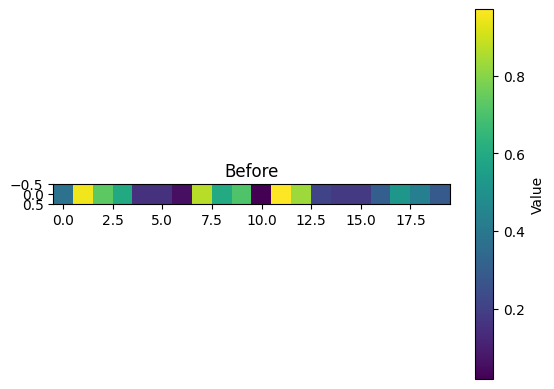

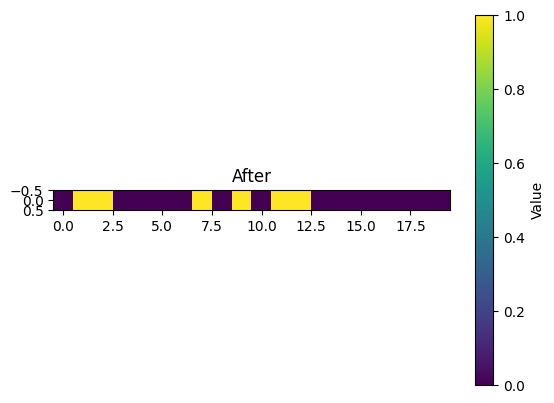

In [15]:
import numpy as np
import matplotlib.pyplot as plt
# set seed for randomness
np.random.seed(42)
test_array = np.random.rand(1, 20)
plt.imshow(test_array, cmap = "viridis", aspect = "equal", interpolation = "nearest")

# below 0.7 set to 0 above set to  1
plt.colorbar(label="Value")
plt.title("Before")
plt.show()

binary_array = np.zeros_like(test_array)
np.greater(test_array, 0.7, out=binary_array)

# Plot as a 1x50 pixel grid
plt.imshow(binary_array, cmap="viridis", aspect = "equal", interpolation="nearest")
plt.colorbar(label="Value")  # optional, shows 0/1
plt.title("After")
plt.show()

TypeError: FigureBase.colorbar() missing 1 required positional argument: 'mappable'

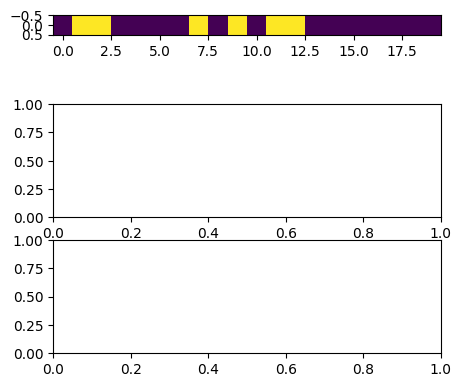

In [16]:
# Plot as a 1x50 pixel grid
# subplot 1 by 3

fig, axs = plt.subplots(ncols = 1, nrows = 3, figsize = (5,5))

axs[0].imshow(binary_array, cmap="viridis", aspect = "equal", interpolation="nearest")




fig.colorbar(label="Value")  # optional, shows 0/1
plt.title("After")
plt.show()

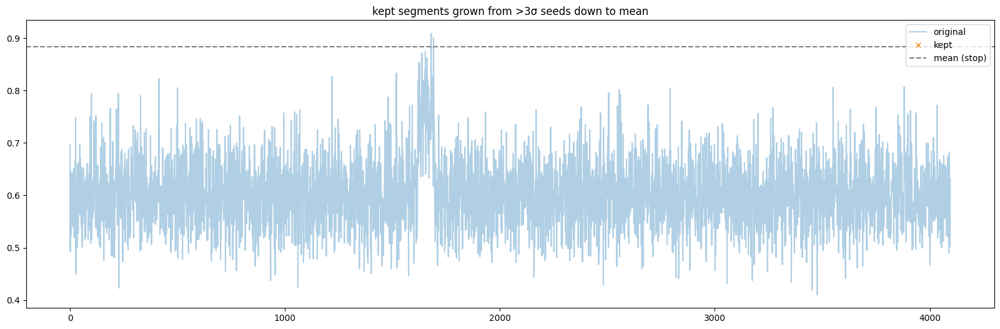

In [109]:
# --- Grow-from-3σ-seeds to mean (single row: baseline_object) ---
from scipy.ndimage import gaussian_filter1d


# params
seed_sigma   = 3.0     # seeds > mean + 3σ
smooth_sigma = 1.5     # smoothing for stability (logic only)
stop_level   = mean    # grow down to this level
min_width    = 6       # reject narrow noise spikes
min_area     = 0.5     # reject tiny bumps (area above mean in value*pix)

x = np.asarray(baseline_object, float)
work = gaussian_filter1d(x, sigma=smooth_sigma, mode='nearest')  # used for logic only
upper = mean + seed_sigma * std

seeds = np.where(work > upper)[0]
mask = np.zeros_like(x, dtype=bool)
if seeds.size:
    splits = np.where(np.diff(seeds) > 1)[0] + 1
    groups = np.split(seeds, splits)

    for g in groups:
        c = g[np.argmax(work[g])]         # center at strongest seed
        L = c
        while L-1 >= 0 and work[L-1] >= stop_level: L -= 1
        R = c
        while R+1 < x.size and work[R+1] >= stop_level: R += 1

        width = R - L + 1
        area  = np.trapz(np.clip(work[L:R+1] - stop_level, 0, None))
        if width >= min_width or area >= min_area:
            mask[L:R+1] = True

# result
kept = np.where(mask, x, np.nan)

# plots
plt.figure(figsize=(20,6))
plt.title("kept segments grown from >3σ seeds down to mean")
plt.plot(baseline_object, alpha=0.35, label="original")
plt.plot(np.where(mask, baseline_object, np.nan), "x", label="kept")
plt.axhline(stop_level, ls="--", c="k", alpha=0.5, label="mean (stop)")
plt.legend(); plt.show()


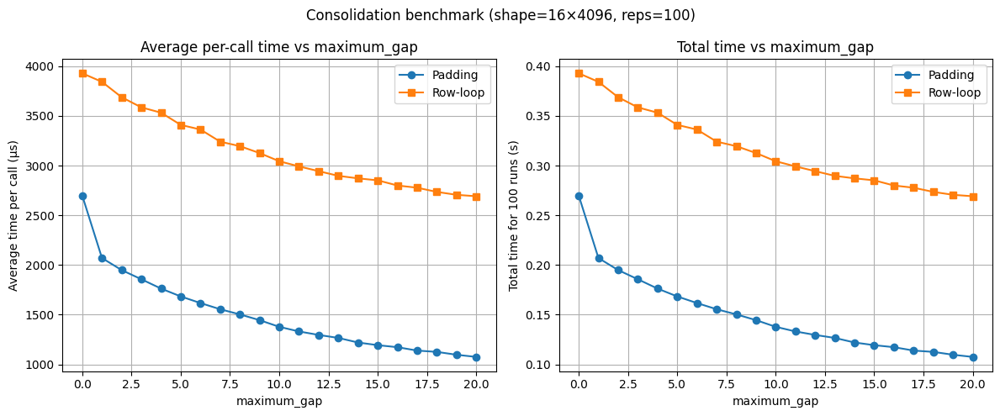

In [18]:
# ============================================================
# Benchmark: padding vs row-loop, 1000 reps per max_gap
# ============================================================

import numpy as np
import time
import matplotlib.pyplot as plt
import gc

# --- Consolidation helpers (same as before) ---

def consolidate_1d(mask_1d: np.ndarray, maximum_gap: int) -> np.ndarray:
    b = mask_1d.astype(np.uint8, copy=False).ravel()
    if b.size == 0 or b.sum() == 0:
        return np.zeros_like(b, dtype=bool)
    d = np.diff(b, prepend=0, append=0)
    starts = np.flatnonzero(d == 1)
    ends   = np.flatnonzero(d == -1) - 1
    if starts.size == 0:
        return np.zeros_like(b, dtype=bool)
    gaps = (starts[1:] - ends[:-1]) - 1
    cuts = np.where(gaps > maximum_gap)[0]
    merged_starts = np.r_[starts[0], starts[cuts + 1]]
    merged_ends   = np.r_[ends[cuts], ends[-1]]
    buf = np.zeros(b.size + 1, dtype=np.int32)
    np.add.at(buf, merged_starts, 1)
    np.add.at(buf, merged_ends + 1, -1)
    return np.cumsum(buf[:-1]) > 0

def consolidate_rows_with_padding(mask_2d: np.ndarray, maximum_gap: int) -> np.ndarray:
    rows, cols = mask_2d.shape
    sep = maximum_gap + 1
    work = np.zeros((rows, cols + sep), dtype=bool)
    work[:, :cols] = mask_2d.astype(bool, copy=False)
    flat = work.ravel()
    cons_flat = consolidate_1d(flat, maximum_gap)
    return cons_flat.reshape(rows, cols + sep)[:, :cols]

def consolidate_rows_loop(mask_2d: np.ndarray, maximum_gap: int) -> np.ndarray:
    rows, cols = mask_2d.shape
    out = np.empty_like(mask_2d, dtype=bool)
    buf = np.zeros(cols + 1, dtype=np.int32)
    for r in range(rows):
        b = mask_2d[r].astype(np.uint8, copy=False)
        if b.sum() == 0:
            out[r].fill(False)
            continue
        d = np.diff(b, prepend=0, append=0)
        starts = np.flatnonzero(d == 1)
        ends   = np.flatnonzero(d == -1) - 1
        if starts.size == 0:
            out[r].fill(False)
            continue
        gaps = (starts[1:] - ends[:-1]) - 1
        cuts = np.where(gaps > maximum_gap)[0]
        ms = np.r_[starts[0], starts[cuts + 1]]
        me = np.r_[ends[cuts], ends[-1]]
        buf.fill(0)
        np.add.at(buf, ms, 1)
        np.add.at(buf, me + 1, -1)
        out[r] = np.cumsum(buf[:-1]) > 0
    return out

# --- Benchmark setup ---
rng = np.random.default_rng(12345)
rows, cols = 16, 4096
true_prob = 0.1
mask = (rng.random((rows, cols)) < true_prob)

max_gaps = np.arange(0, 21)
reps = 100

avg_pad, avg_loop = [], []
tot_pad, tot_loop = [], []

for g in max_gaps:
    # Warm-up
    _ = consolidate_rows_with_padding(mask, g)
    _ = consolidate_rows_loop(mask, g)

    gc.collect(); gc.disable()

    # Padding timings
    t0 = time.perf_counter()
    for _ in range(reps):
        out_pad = consolidate_rows_with_padding(mask, g)
    t1 = time.perf_counter()
    total_pad = t1 - t0

    # Loop timings
    t0 = time.perf_counter()
    for _ in range(reps):
        out_loop = consolidate_rows_loop(mask, g)
    t1 = time.perf_counter()
    total_loop = t1 - t0

    gc.enable()

    if not np.array_equal(out_pad, out_loop):
        raise AssertionError(f"Mismatch at gap={g}")

    tot_pad.append(total_pad)
    tot_loop.append(total_loop)
    avg_pad.append(total_pad / reps * 1e6)   # µs per call
    avg_loop.append(total_loop / reps * 1e6) # µs per call

# --- Plot results ---
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Average times
axes[0].plot(max_gaps, avg_pad, 'o-', label="Padding")
axes[0].plot(max_gaps, avg_loop, 's-', label="Row-loop")
axes[0].set_xlabel("maximum_gap")
axes[0].set_ylabel("Average time per call (µs)")
axes[0].set_title("Average per-call time vs maximum_gap")
axes[0].grid(True); axes[0].legend()

# Total times
axes[1].plot(max_gaps, tot_pad, 'o-', label="Padding")
axes[1].plot(max_gaps, tot_loop, 's-', label="Row-loop")
axes[1].set_xlabel("maximum_gap")
axes[1].set_ylabel(f"Total time for {reps} runs (s)")
axes[1].set_title("Total time vs maximum_gap")
axes[1].grid(True); axes[1].legend()

plt.suptitle(f"Consolidation benchmark (shape={rows}×{cols}, reps={reps})")
plt.tight_layout()
plt.show()


In [66]:
thresholded_dataset = basic_signal_thresholding(test_dataset.copy(), threshold_sigma=1.0)

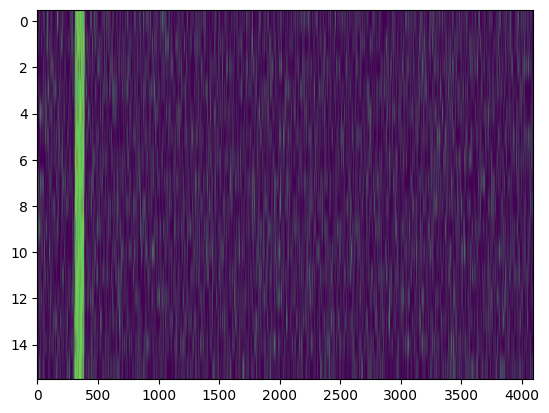

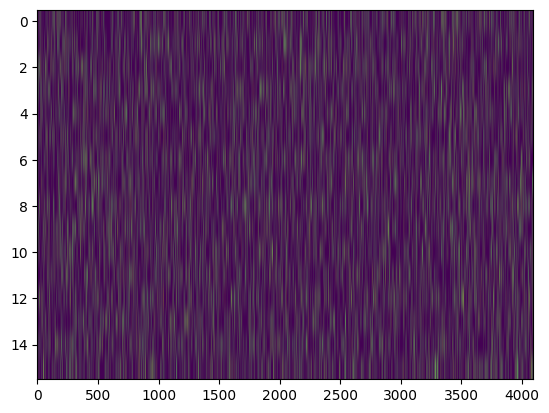

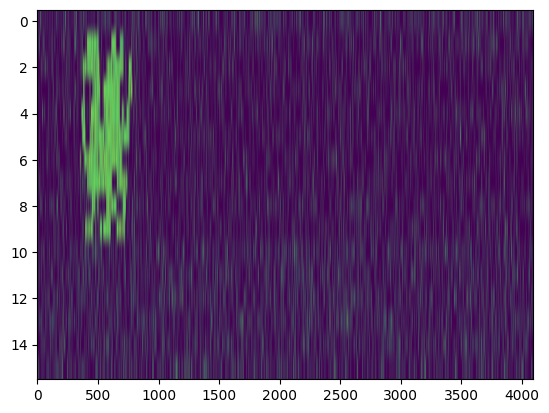

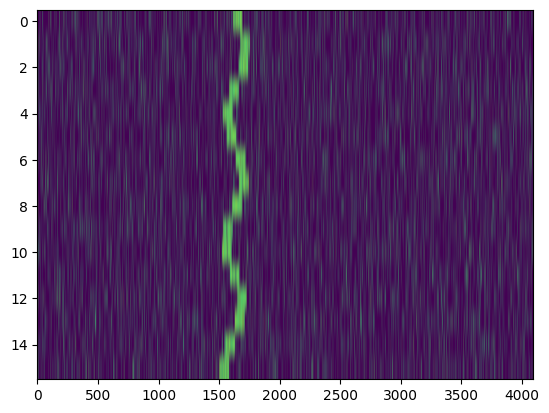

In [67]:
plt.imshow(thresholded_dataset[0], aspect = 'auto')
plt.show()
plt.imshow(thresholded_dataset[14], aspect = 'auto')
plt.show()
plt.imshow(thresholded_dataset[32], aspect = 'auto')
plt.show()
plt.imshow(thresholded_dataset[56], aspect = 'auto')
plt.show()


In [68]:
from scipy import ndimage as ndi

def robust_row_whiten(x, eps=1e-9):
    med = np.median(x, axis=-1, keepdims=True)
    mad = np.median(np.abs(x - med), axis=-1, keepdims=True) + eps
    return (x - med) / (1.4826 * mad)

def detect_vertical_mask_scipy(frame, k_len=9, k_width=3, sigma=3.5, min_run=5, restore_thickness=2):
    """
    frame: (16, 4096)
    k_len: vertical kernel height for matched filter (odd, e.g. 9–15)
    k_width: kernel width (1–3 keeps thin tracks)
    sigma: threshold in MAD-based σ on the response map
    min_run: minimum contiguous vertical run to keep
    restore_thickness: optional dilation radius to thicken result
    """
    # 1) robust z-scores per row
    Z = robust_row_whiten(frame)

    # 2) matched filter (tall skinny box); reflect padding avoids edge loss
    kernel = np.ones((k_len, k_width), dtype=float) / (k_len * k_width)
    resp = ndi.correlate(Z, kernel, mode="reflect")

    # 3) robust global threshold on response
    med = np.median(resp)
    mad = np.median(np.abs(resp - med)) + 1e-9
    thr = med + sigma * 1.4826 * mad
    mask = resp > thr

    # 4) enforce vertical contiguity
    se_vert = np.ones((min_run, 1), dtype=bool)
    clean = ndi.binary_opening(mask, structure=se_vert)

    # 5) optional thickening
    if restore_thickness and restore_thickness > 0:
        se_dil = np.ones((restore_thickness, k_width), dtype=bool)
        clean = ndi.binary_dilation(clean, structure=se_dil)

    return clean, resp


def apply_mask_keep_values(frame, mask):
    return np.where(mask, frame, 0).astype(frame.dtype)


  0%|          | 0/100 [00:00<?, ?it/s]

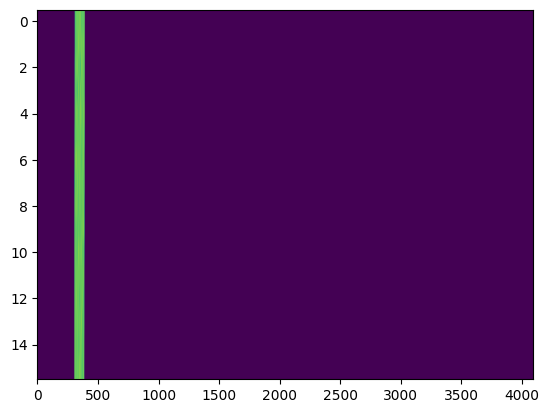

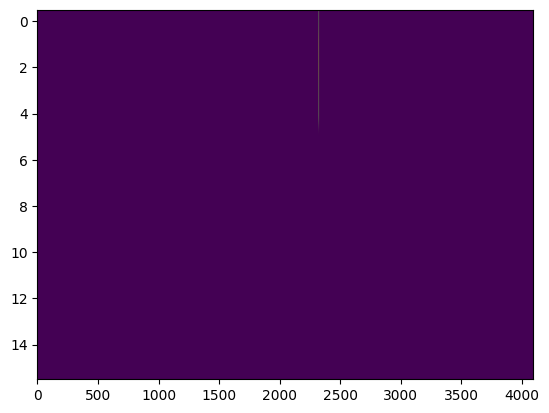

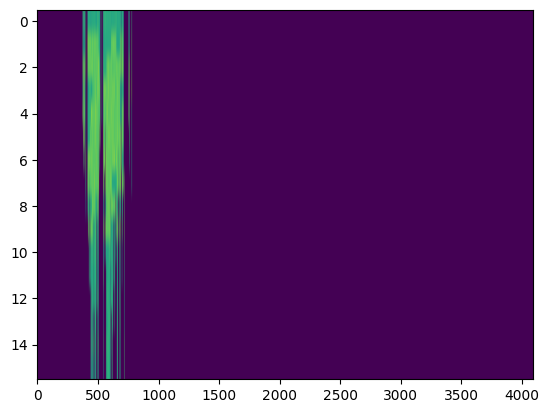

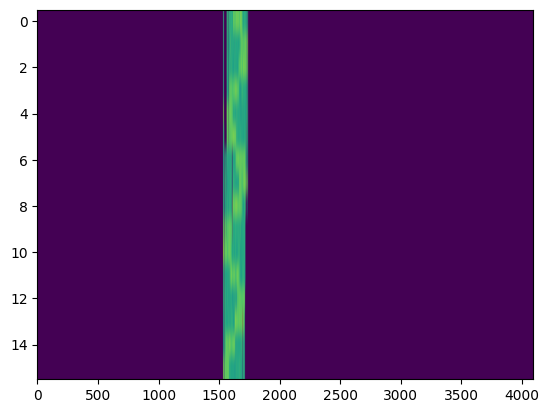

In [71]:
thresholded = []
for i in tqdm(range(0,100)):
    mask, resp = detect_vertical_mask_scipy(
        test_dataset[i],
        k_len=20,       # longer -> stricter vertical coherence
        k_width=3,
        sigma=4,      # raise if speckles persist (e.g., 4.0)
        min_run=5,      # require 5+ stacked pixels
        restore_thickness=2
    )
    filtered = apply_mask_keep_values(test_dataset[i], mask)
    if i == 0 or i == 14 or i == 32 or i == 56:
        plt.imshow(filtered, aspect='auto'); plt.show()
        plt.show()


In [76]:
import numpy as np
import cv2
from tqdm import tqdm
import matplotlib.pyplot as plt

def median_threshold(frame, threshold_sigma=1.0, eps=1e-9):
    """
    Row-wise thresholding:
    Zero everything below (median + threshold_sigma*std) in each row.
    """
    med = np.median(frame, axis=-1, keepdims=True)
    std = np.std(frame, axis=-1, keepdims=True) + eps
    mask = frame > (med + threshold_sigma * std)
    return np.where(mask, frame, 0).astype(frame.dtype)

def bilateral_filter(frame, sigma_spatial=2.0, sigma_color=0.5, win_size=7):
    """
    Bilateral filtering using OpenCV.
    frame must be float32 or uint8.
    """
    f = frame.astype(np.float32)
    d = win_size                   # diameter of neighborhood
    sigmaColor = sigma_color * 255 # intensity sigma scaled for float32 range
    sigmaSpace = sigma_spatial     # spatial sigma
    return cv2.bilateralFilter(f, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)

def threshold_then_bilateral(frame, threshold_sigma=1.0,
                             sigma_spatial=2.0, sigma_color=0.5, win_size=7):
    thr = median_threshold(frame, threshold_sigma)
    return bilateral_filter(thr, sigma_spatial, sigma_color, win_size)


  0%|          | 0/100 [00:00<?, ?it/s]

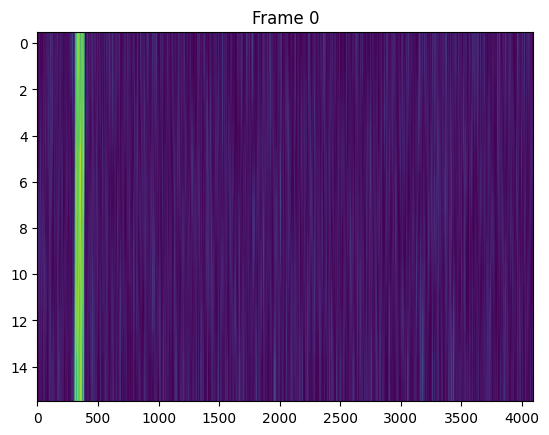

  1%|          | 1/100 [00:00<00:53,  1.83it/s]

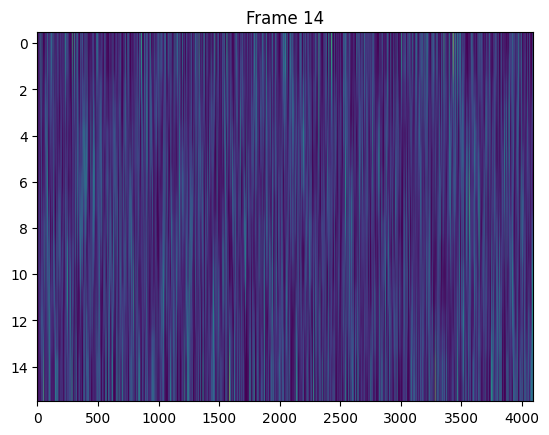

 15%|█▌        | 15/100 [00:00<00:04, 19.06it/s]

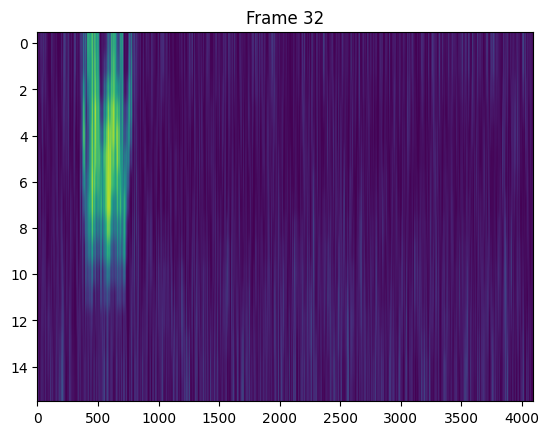

 56%|█████▌    | 56/100 [00:01<00:00, 58.05it/s]

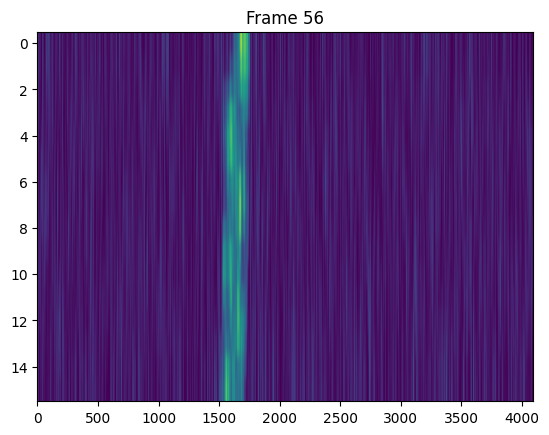

100%|██████████| 100/100 [00:01<00:00, 53.08it/s]


In [77]:
thresholded = []

for i in tqdm(range(100)):
    filtered = threshold_then_bilateral(
        test_dataset[i],
        threshold_sigma=1.5,
        sigma_spatial=2.0,
        sigma_color=0.4,
        win_size=7
    )
    thresholded.append(filtered)

    if i in (0, 14, 32, 56):
        plt.figure()
        plt.imshow(filtered, aspect='auto')
        plt.title(f"Frame {i}")
        plt.show()

thresholded = np.stack(thresholded, axis=0)  # (100, 16, 4096)


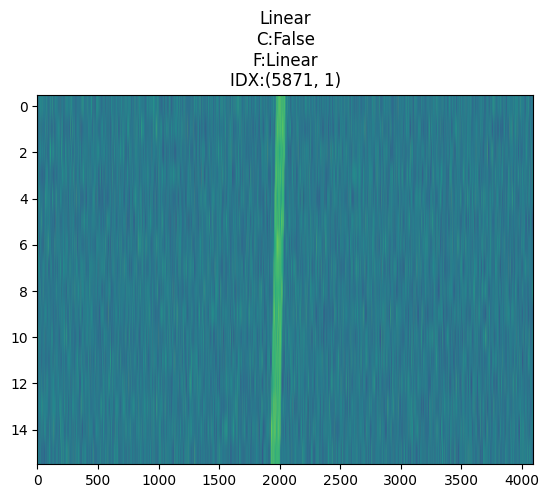

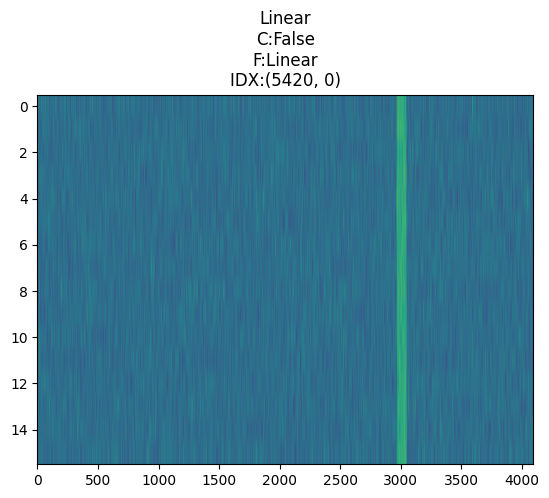

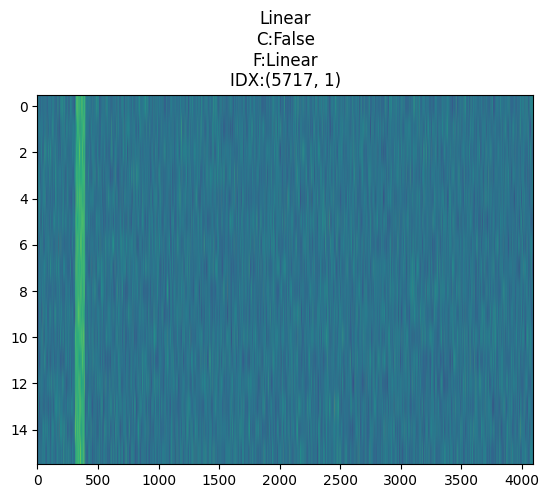

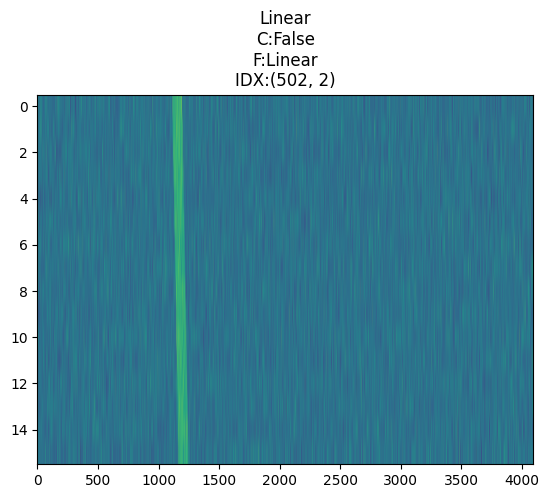

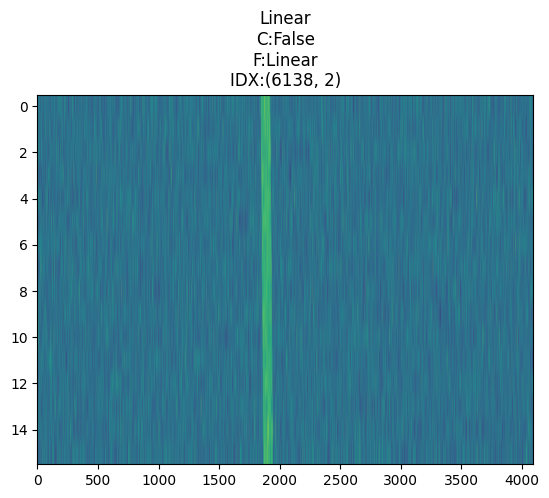

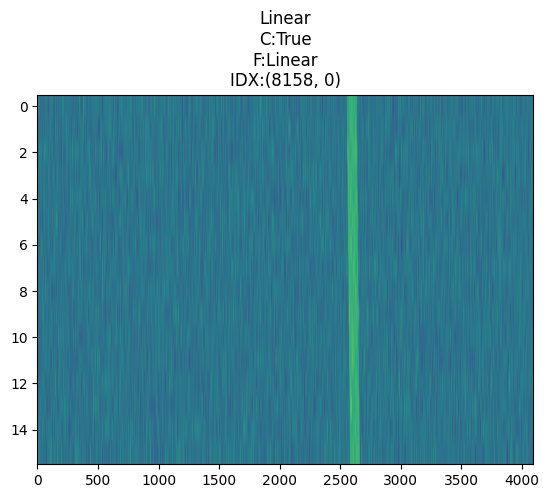

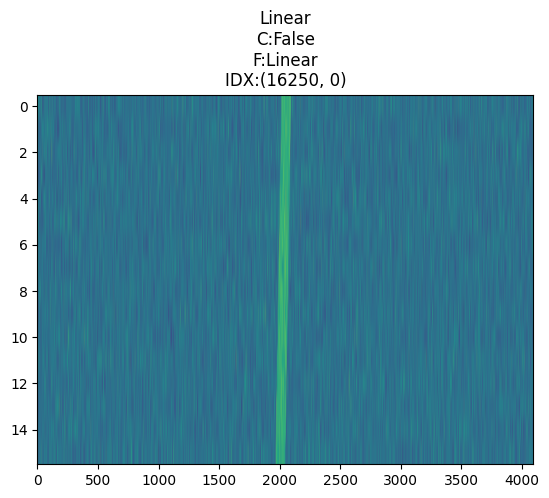

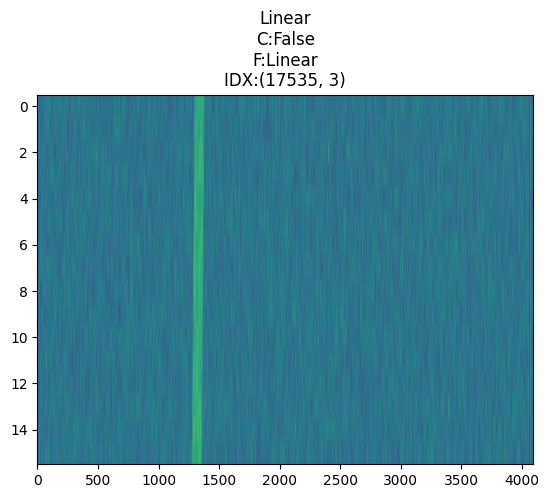

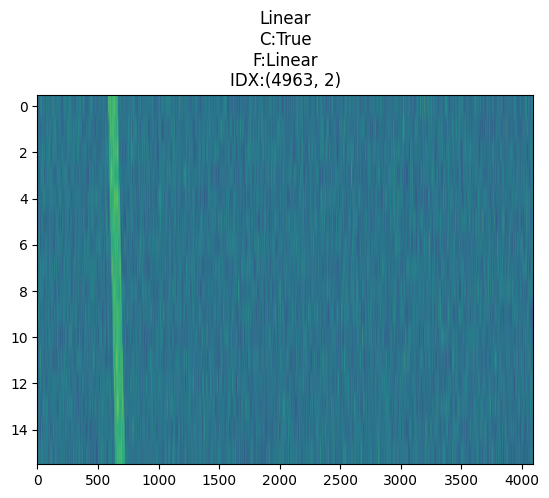

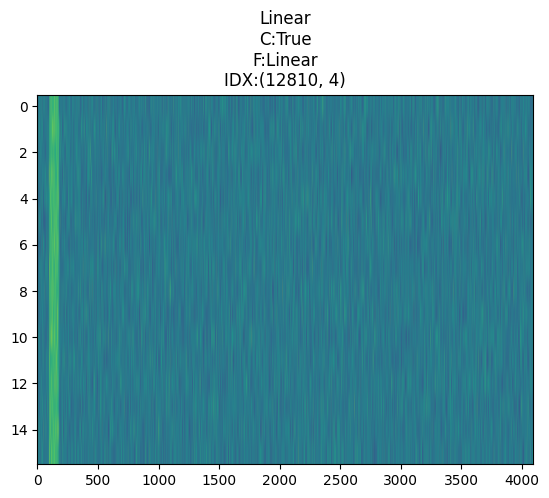

In [45]:
for i in range(len(test_dataset)):
    plt.imshow(test_dataset[i], aspect='auto', cmap='viridis')
    inj_type, cadence_label, frame_flag, orig_idx = y_test[i]
    plt.title(f"{inj_type}\nC:{cadence_label}\nF:{frame_flag}\nIDX:{orig_idx}")
    plt.show()

In [ ]:
1+1

In [42]:
test_dataset.shape

(16, 4096)

In [29]:
normalised_dataset = basic_signal_thresholding(y_test.copy(), 2)

TypeError: '<' not supported between instances of 'bool' and 'str'

In [ ]:
plt.imshow(normalised_dataset[0,0,:,:])

plt.show()